# Multi-Subject Reenactment Finetuning

This notebook finetunes the FSGAN reenactment generator on **all subjects** from your custom dataset.

**Purpose:** Adapt the pretrained model to your specific dataset distribution.

**Contents:**
1. Load custom dataset (LFW or other)
2. Create paired dataset for reenactment training
3. Setup losses and optimizer
4. Train the model
5. Evaluate and test finetuned model
6. Run full face swap pipeline with finetuned model

## 1. Setup & Imports

In [1]:
import sys
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
import numpy as np
import cv2
from pathlib import Path
from tqdm import tqdm
import matplotlib.pyplot as plt

from fsgan.utils.utils import load_model
from fsgan.utils.img_utils import bgr2tensor, create_pyramid, tensor2bgr
from fsgan.utils.landmarks_utils import LandmarksHeatMapDecoder, filter_landmarks
from fsgan.criterions.vgg_loss import VGGLoss
from fsgan.notebook_helpers.reenact_preprocess import run_full_pipeline
from fsgan.utils.obj_factory import obj_factory

import dataloader

ROOT = Path('.')
WEIGHTS_DIR = ROOT / 'fsgan' / 'weights'
OUT_DIR = ROOT / 'outputs'
OUT_DIR.mkdir(exist_ok=True)

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print(f'Using device: {device}')

Using device: cuda:0


/home/e20220005499/Documents/Face-Swap-M2/venv/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 2. Configuration

In [2]:
# Dataset configuration
IMAGE_SIZE = 256
NB_IMAGES = 10  # Images per person
DATASET_PATH = "../data/Face-Swap-M2-Dataset/dataset/smaller"

# Training configuration
FINETUNE_EPOCHS = 100
FINETUNE_LR = 1e-5  # Lower learning rate for finetuning
FINETUNE_BATCH_SIZE = 2  # Reduced from 4 to prevent OOM
GRADIENT_ACCUMULATION_STEPS = 2  # Accumulate gradients to simulate batch_size=4
SAVE_EVERY = 30  # Save checkpoint every N epochs

# Loss weights (from FSGAN paper)
WEIGHT_PIXEL = 0.1      # L1 pixel loss
WEIGHT_PERCEPTUAL = 1.0  # VGG perceptual loss
WEIGHT_REC = 1.0         # Combined reconstruction weight

print("Configuration:")
print(f"  Dataset: {DATASET_PATH}")
print(f"  Image size: {IMAGE_SIZE}")
print(f"  Images per person: {NB_IMAGES}")
print(f"  Epochs: {FINETUNE_EPOCHS}")
print(f"  Batch size: {FINETUNE_BATCH_SIZE}")
print(f"  Gradient accumulation: {GRADIENT_ACCUMULATION_STEPS} (effective batch: {FINETUNE_BATCH_SIZE * GRADIENT_ACCUMULATION_STEPS})")
print(f"  Learning rate: {FINETUNE_LR}")

Configuration:
  Dataset: ../data/Face-Swap-M2-Dataset/dataset/smaller
  Image size: 256
  Images per person: 10
  Epochs: 100
  Batch size: 2
  Gradient accumulation: 2 (effective batch: 4)
  Learning rate: 1e-05


## 3. Load Dataset

In [3]:
# Load your custom dataset
train_dataset, test_dataset, nb_classes = dataloader.make_dataset(
    DATASET_PATH, 
    NB_IMAGES, 
    IMAGE_SIZE, 
    0.8, 
    crop_faces=False
)

print(f"Train samples: {len(train_dataset)}")
print(f"Test samples: {len(test_dataset)}")
print(f"Number of identities: {nb_classes}")

# Show class distribution
class_counts = np.bincount([label for _, label in train_dataset])
for cls, count in enumerate(class_counts):
    print(f"  Identity {cls}: {count} images")

Building dataset 

Train samples: 65
Test samples: 19
Number of identities: 10
  Identity 0: 8 images
  Identity 1: 6 images
  Identity 2: 7 images
  Identity 3: 5 images
  Identity 4: 4 images
  Identity 5: 7 images
  Identity 6: 8 images
  Identity 7: 7 images
  Identity 8: 8 images
  Identity 9: 5 images
Train samples: 65
Test samples: 19
Number of identities: 10
  Identity 0: 8 images
  Identity 1: 6 images
  Identity 2: 7 images
  Identity 3: 5 images
  Identity 4: 4 images
  Identity 5: 7 images
  Identity 6: 8 images
  Identity 7: 7 images
  Identity 8: 8 images
  Identity 9: 5 images


## 4. Create Paired Dataset for Reenactment

For reenactment training, we need pairs of images from the **same person** with different poses/expressions.

In [4]:
class ReenactmentPairDataset(Dataset):
    """
    Creates pairs of images from the same person for reenactment training.
    """
    def __init__(self, base_dataset, resolution=256):
        self.base_dataset = base_dataset
        self.resolution = resolution
        
        # Group samples by label (person identity)
        self.label_to_indices = {}
        for idx in range(len(base_dataset)):
            _, label = base_dataset[idx]
            if isinstance(label, torch.Tensor):
                label = label.item()
            if label not in self.label_to_indices:
                self.label_to_indices[label] = []
            self.label_to_indices[label].append(idx)
        
        # Filter labels with at least 2 samples
        self.valid_labels = [l for l, indices in self.label_to_indices.items() if len(indices) >= 2]
        
        # Create list of valid indices
        self.valid_indices = []
        for label in self.valid_labels:
            self.valid_indices.extend(self.label_to_indices[label])
        
        print(f"ReenactmentPairDataset: {len(self.valid_labels)} identities with 2+ images")
        print(f"Total valid samples: {len(self.valid_indices)}")
    
    def __len__(self):
        return len(self.valid_indices)
    
    def __getitem__(self, idx):
        # Get source sample
        src_idx = self.valid_indices[idx]
        src_img, src_label = self.base_dataset[src_idx]
        if isinstance(src_label, torch.Tensor):
            src_label = src_label.item()
        
        # Get a different sample from the same person
        same_person_indices = self.label_to_indices[src_label]
        tgt_idx = src_idx
        while tgt_idx == src_idx:
            tgt_idx = same_person_indices[np.random.randint(len(same_person_indices))]
        
        tgt_img, _ = self.base_dataset[tgt_idx]
        
        return src_img, tgt_img, src_label

# Create paired datasets
finetune_dataset = ReenactmentPairDataset(train_dataset, resolution=IMAGE_SIZE)
finetune_loader = DataLoader(
    finetune_dataset, 
    batch_size=FINETUNE_BATCH_SIZE, 
    shuffle=True,
    num_workers=4,
    drop_last=True
)

print(f"\nFinetune dataloader: {len(finetune_loader)} batches")

ReenactmentPairDataset: 10 identities with 2+ images
Total valid samples: 65

Finetune dataloader: 32 batches


## 5. Load Pretrained Models

In [5]:
print("Loading pretrained models...")

# Load reenactment generator
reenact_w = WEIGHTS_DIR / 'nfv_msrunet_256_1_2_reenactment_v2.1.pth'
Gr_finetune, ckpt = load_model(str(reenact_w), 'reenactment', device=device, return_checkpoint=True)
Gr_finetune.train()
print(f"✓ Reenactment generator: {ckpt.get('arch', 'unknown')}")

# Load landmarks model (frozen)
lms_w = WEIGHTS_DIR / 'hr18_wflw_landmarks.pth'
L_frozen, _ = load_model(str(lms_w), 'landmarks', device=device, return_checkpoint=True)
L_frozen.eval()
for param in L_frozen.parameters():
    param.requires_grad = False
print("✓ Landmarks model (frozen)")

# Get generator properties
n_local = getattr(Gr_finetune, 'n_local_enhancers', None)
if n_local is None and hasattr(Gr_finetune, 'module'):
    n_local = getattr(Gr_finetune.module, 'n_local_enhancers', None)
n_local = n_local if n_local is not None else 1
n_levels = n_local + 1
print(f"Pyramid levels: {n_levels}")

# ImageNet normalization for landmarks model
imagenet_mean = torch.tensor([0.485, 0.456, 0.406], device=device).view(1, 3, 1, 1)
imagenet_std = torch.tensor([0.229, 0.224, 0.225], device=device).view(1, 3, 1, 1)

Loading pretrained models...
=> Loading reenactment model: "nfv_msrunet_256_1_2_reenactment_v2.1.pth"...
✓ Reenactment generator: res_unet.MultiScaleResUNet(in_nc=101,out_nc=3,flat_layers=(2,2,2,2),ngf=128)
=> Loading landmarks model: "hr18_wflw_landmarks.pth"...
✓ Reenactment generator: res_unet.MultiScaleResUNet(in_nc=101,out_nc=3,flat_layers=(2,2,2,2),ngf=128)
=> Loading landmarks model: "hr18_wflw_landmarks.pth"...
✓ Landmarks model (frozen)
Pyramid levels: 2
✓ Landmarks model (frozen)
Pyramid levels: 2


## 6. Setup Loss Functions

In [6]:
print("Initializing loss functions...")

# Pixel-wise L1 loss
criterion_pixel = nn.L1Loss().to(device)

# Perceptual loss using VGG (identity preservation)
try:
    vgg_id_path = str(WEIGHTS_DIR / 'vggface2_vgg19_256_1_2_id.pth')
    criterion_id = VGGLoss(vgg_id_path).to(device)
    criterion_id.eval()
    print("✓ VGG identity loss")
except Exception as e:
    print(f"⚠ Could not load VGG identity loss: {e}")
    criterion_id = None

# Attribute loss
try:
    vgg_attr_path = str(WEIGHTS_DIR / 'celeba_vgg19_256_2_0_28_attr.pth')
    criterion_attr = VGGLoss(vgg_attr_path).to(device)
    criterion_attr.eval()
    print("✓ VGG attribute loss")
except Exception as e:
    print(f"⚠ Could not load VGG attribute loss: {e}")
    criterion_attr = None

# Optimizer
optimizer_G = optim.Adam(Gr_finetune.parameters(), lr=FINETUNE_LR, betas=(0.5, 0.999))
print(f"✓ Optimizer: Adam, LR={FINETUNE_LR}")

Initializing loss functions...
✓ VGG identity loss
✓ VGG identity loss
✓ VGG attribute loss
✓ Optimizer: Adam, LR=1e-05
✓ VGG attribute loss
✓ Optimizer: Adam, LR=1e-05


## 7. Helper Functions

In [7]:
def prepare_reenactment_input(src_batch, tgt_batch, L_model, n_pyramid_levels, device):
    """
    Prepare source image pyramid with target landmarks context.
    """
    # Ensure images are in [-1, 1] range
    if src_batch.min() >= 0:
        src_normalized = src_batch * 2 - 1
    else:
        src_normalized = src_batch
    
    if tgt_batch.min() >= 0:
        tgt_normalized = tgt_batch * 2 - 1
    else:
        tgt_normalized = tgt_batch
    
    # Prepare target for landmarks model
    tgt_01 = (tgt_normalized + 1) / 2
    tgt_for_lms = (tgt_01 - imagenet_mean) / imagenet_std
    
    # Get landmarks from target
    with torch.no_grad():
        tgt_landmarks = L_model(tgt_for_lms)
        tgt_landmarks = filter_landmarks(tgt_landmarks)
        # Delete intermediate tensors
        del tgt_01, tgt_for_lms
    
    # Build source pyramid
    src_pyd = create_pyramid(src_normalized, n_pyramid_levels)
    
    # Build input list
    input_list = []
    for p in range(len(src_pyd)):
        pyd_h, pyd_w = src_pyd[p].shape[2:]
        context = F.interpolate(tgt_landmarks, size=(pyd_h, pyd_w), mode='bilinear', align_corners=False)
        context = filter_landmarks(context)
        inp = torch.cat((src_pyd[p], context), dim=1)
        input_list.append(inp)
    
    # Delete pyramid and landmarks after building input list
    del src_pyd, tgt_landmarks, context
    
    return input_list, tgt_normalized

print("✓ Helper functions defined")

✓ Helper functions defined


## 8. Training Loop

In [8]:
def finetune_reenactment(model, dataloader, optimizer, epochs, save_dir, resume_from=None):
    """
    Finetune the reenactment generator on paired face data.
    
    Args:
        resume_from: Path to checkpoint to resume from, or None to start fresh
    """
    save_path = Path(save_dir)
    save_path.mkdir(parents=True, exist_ok=True)
    
    model.train()
    history = {'loss': [], 'loss_pixel': [], 'loss_id': [], 'loss_attr': []}
    start_epoch = 0
    
    # Resume from checkpoint if provided
    if resume_from is not None:
        print(f"Resuming from checkpoint: {resume_from}")
        resume_ckpt = torch.load(resume_from, map_location=device)
        model.load_state_dict(resume_ckpt['state_dict'])
        optimizer.load_state_dict(resume_ckpt['optimizer'])
        start_epoch = resume_ckpt.get('epoch', 0)
        if 'history' in resume_ckpt:
            history = resume_ckpt['history']
        print(f"✓ Resumed from epoch {start_epoch}")
        print(f"  Previous best loss: {history['loss'][-1] if history['loss'] else 'N/A'}")
    
    print("="*60)
    print("STARTING FINETUNING" if start_epoch == 0 else "RESUMING FINETUNING")
    print("="*60)
    print(f"Epochs: {start_epoch + 1} to {epochs}")
    print(f"Batches per epoch: {len(dataloader)}")
    print(f"Save directory: {save_path}")
    print(f"Gradient accumulation steps: {GRADIENT_ACCUMULATION_STEPS}")
    print("="*60)
    
    for epoch in range(start_epoch, epochs):
        epoch_losses = {'total': 0, 'pixel': 0, 'id': 0, 'attr': 0}
        n_batches = 0
        accumulation_step = 0
        
        pbar = tqdm(dataloader, desc=f"Epoch {epoch+1}/{epochs}")
        
        for batch_idx, (src_img, tgt_img, labels) in enumerate(pbar):
            src_img = src_img.to(device)
            tgt_img = tgt_img.to(device)

            
            # Prepare inputs
            input_list, tgt_normalized = prepare_reenactment_input(
                src_img, tgt_img, L_frozen, n_levels, device
            )
            
            # Forward pass
            output = model(input_list)
            pred = output[-1] if isinstance(output, (list, tuple)) else output
            
            # Compute losses
            loss_pixel = criterion_pixel(pred, tgt_normalized)
            
            if criterion_id is not None:
                loss_id = criterion_id(pred, tgt_normalized)
            else:
                loss_id = torch.tensor(0.0, device=device)
            
            if criterion_attr is not None:
                loss_attr = criterion_attr(pred, tgt_normalized)
            else:
                loss_attr = torch.tensor(0.0, device=device)
            
            # Combined loss (normalize by accumulation steps)
            loss_rec = WEIGHT_PIXEL * loss_pixel + 0.5 * loss_id + 0.5 * loss_attr
            loss_total = WEIGHT_REC * loss_rec / GRADIENT_ACCUMULATION_STEPS
            
            # Backward pass (accumulate gradients)
            loss_total.backward()
            
            # Track losses (extract values before deleting tensors)
            # Multiply back to get actual loss value for logging
            total_val = loss_total.item() * GRADIENT_ACCUMULATION_STEPS
            pixel_val = loss_pixel.item()
            id_val = loss_id.item() if criterion_id else 0
            attr_val = loss_attr.item() if criterion_attr else 0
            
            epoch_losses['total'] += total_val
            epoch_losses['pixel'] += pixel_val
            epoch_losses['id'] += id_val
            epoch_losses['attr'] += attr_val
            n_batches += 1
            
            # CRITICAL: Explicitly delete tensors to free GPU memory
            del input_list, output, pred, loss_pixel, loss_id, loss_attr, loss_rec, loss_total
            del src_img, tgt_img, tgt_normalized
            
            # Update weights after accumulating gradients
            accumulation_step += 1
            if accumulation_step % GRADIENT_ACCUMULATION_STEPS == 0:
                optimizer.step()
                optimizer.zero_grad()
                accumulation_step = 0
            
            pbar.set_postfix({
                'loss': f"{total_val:.4f}",
                'pix': f"{pixel_val:.4f}"
            })
            
            # Clear cache every few batches (not every iteration)
            if (n_batches % 5) == 0:
                torch.cuda.empty_cache()
        
        # Make sure to step optimizer at end of epoch if needed
        if accumulation_step > 0:
            optimizer.step()
            optimizer.zero_grad()
        
        # Epoch summary
        avg_loss = epoch_losses['total'] / n_batches
        avg_pixel = epoch_losses['pixel'] / n_batches
        avg_id = epoch_losses['id'] / n_batches
        avg_attr = epoch_losses['attr'] / n_batches
        
        history['loss'].append(avg_loss)
        history['loss_pixel'].append(avg_pixel)
        history['loss_id'].append(avg_id)
        history['loss_attr'].append(avg_attr)
        
        print(f"Epoch {epoch+1}: Loss={avg_loss:.4f}, Pixel={avg_pixel:.4f}, ID={avg_id:.4f}")
        
        # Save checkpoint
        if (epoch + 1) % SAVE_EVERY == 0 or epoch == epochs - 1:
            ckpt_path = save_path / f'reenact_finetuned_epoch{epoch+1}.pth'
            torch.save({
                'epoch': epoch + 1,
                'state_dict': model.state_dict(),
                'optimizer': optimizer.state_dict(),
                'arch': ckpt.get('arch', 'unknown'),
                'history': history,
            }, ckpt_path)
            print(f"  → Saved checkpoint: {ckpt_path}")
    
    print("\n" + "="*60)
    print("FINETUNING COMPLETE")
    print("="*60)
    
    return history

print("✓ Training function defined")

✓ Training function defined


## 9. Run Finetuning

In [9]:
file_name = "reenact_finetuned_epoch100.pth"
finetuned_dir = OUT_DIR / 'finetuned_models'
ckpts = [finetuned_dir / file_name] if (finetuned_dir / file_name).exists() else []

if not ckpts:
    print("No finetuned checkpoints found!")
else:
    latest_ckpt = ckpts[-1]
    print(f"Loading: {latest_ckpt.name}")
    
    ckpt_data = torch.load(str(latest_ckpt), map_location=device)
    Gr_finetune.load_state_dict(ckpt_data['state_dict'])
    print(f"✓ Loaded finetuned model from epoch {ckpt_data.get('epoch', '?')}")

Loading: reenact_finetuned_epoch100.pth
✓ Loaded finetuned model from epoch 100
✓ Loaded finetuned model from epoch 100


### 9.1 Configure Resume (Optional)
If you have a checkpoint from a previous training run, you can resume from it instead of starting from scratch.

In [10]:

RESUME_FROM =  'outputs/finetuned_models/reenact_finetuned_epoch300.pth'


if RESUME_FROM and Path(RESUME_FROM).exists():
    print(f"✓ Will resume from: {RESUME_FROM}")
else:
    if RESUME_FROM:
        print(f"⚠ Checkpoint not found: {RESUME_FROM}")
        print("  Starting fresh training instead")
    RESUME_FROM = None
    print("Starting fresh training")

✓ Will resume from: outputs/finetuned_models/reenact_finetuned_epoch300.pth


In [11]:
allocated_memory = torch.cuda.memory_allocated()
print(f"CUDA memory allocated: {allocated_memory / (1024 ** 2):.2f} MB")

CUDA memory allocated: 1557.26 MB


In [12]:
import os

torch.cuda.empty_cache()
print("CUDA cache emptied.")

torch.cuda.reset_peak_memory_stats()
print("GPU memory stats reset.")

os.system('nvidia-smi --gpu-reset')
print("GPU reset command executed.")

CUDA cache emptied.
GPU memory stats reset.
GPU Reset couldn't run because GPU 00000000:01:00.0 is the primary GPU.
GPU reset command executed.


In [13]:
allocated_memory = torch.cuda.memory_allocated()
print(f"CUDA memory allocated: {allocated_memory / (1024 ** 2):.2f} MB")

CUDA memory allocated: 1557.26 MB


### 9.2 Execute Training

In [14]:
# Run finetuning with optional resume
history = finetune_reenactment(
    model=Gr_finetune,
    dataloader=finetune_loader,
    optimizer=optimizer_G,
    epochs=500,
    save_dir=finetuned_dir,
    resume_from=RESUME_FROM  # Pass checkpoint to resume from
)

Resuming from checkpoint: outputs/finetuned_models/reenact_finetuned_epoch300.pth
✓ Resumed from epoch 300
  Previous best loss: 0.08512574527412653
RESUMING FINETUNING
Epochs: 301 to 500
Batches per epoch: 32
Save directory: outputs/finetuned_models
Gradient accumulation steps: 2
✓ Resumed from epoch 300
  Previous best loss: 0.08512574527412653
RESUMING FINETUNING
Epochs: 301 to 500
Batches per epoch: 32
Save directory: outputs/finetuned_models
Gradient accumulation steps: 2


Epoch 301/500: 100%|██████████| 32/32 [00:09<00:00,  3.24it/s, loss=0.0718, pix=0.0736]


Epoch 301: Loss=0.0848, Pixel=0.1081, ID=0.1196


Epoch 302/500: 100%|██████████| 32/32 [00:09<00:00,  3.37it/s, loss=0.0830, pix=0.0829]


Epoch 302: Loss=0.0851, Pixel=0.1094, ID=0.1200


Epoch 303/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0847, pix=0.1027]


Epoch 303: Loss=0.0861, Pixel=0.1136, ID=0.1211


Epoch 304/500: 100%|██████████| 32/32 [00:09<00:00,  3.40it/s, loss=0.0759, pix=0.0886]


Epoch 304: Loss=0.0849, Pixel=0.1103, ID=0.1196


Epoch 305/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.0724, pix=0.0866]


Epoch 305: Loss=0.0855, Pixel=0.1093, ID=0.1207


Epoch 306/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0930, pix=0.1263]


Epoch 306: Loss=0.0854, Pixel=0.1098, ID=0.1205


Epoch 307/500: 100%|██████████| 32/32 [00:09<00:00,  3.41it/s, loss=0.0776, pix=0.0968]


Epoch 307: Loss=0.0857, Pixel=0.1127, ID=0.1205


Epoch 308/500: 100%|██████████| 32/32 [00:09<00:00,  3.42it/s, loss=0.1046, pix=0.1660]


Epoch 308: Loss=0.0866, Pixel=0.1190, ID=0.1210


Epoch 309/500: 100%|██████████| 32/32 [00:09<00:00,  3.41it/s, loss=0.0776, pix=0.0844]


Epoch 309: Loss=0.0830, Pixel=0.1039, ID=0.1174


Epoch 310/500: 100%|██████████| 32/32 [00:09<00:00,  3.42it/s, loss=0.0908, pix=0.0969]


Epoch 310: Loss=0.0842, Pixel=0.1073, ID=0.1188


Epoch 311/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.0778, pix=0.0894]


Epoch 311: Loss=0.0856, Pixel=0.1144, ID=0.1199


Epoch 312/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.0825, pix=0.0925]


Epoch 312: Loss=0.0851, Pixel=0.1131, ID=0.1196


Epoch 313/500: 100%|██████████| 32/32 [00:09<00:00,  3.40it/s, loss=0.0926, pix=0.1247]


Epoch 313: Loss=0.0845, Pixel=0.1105, ID=0.1188


Epoch 314/500: 100%|██████████| 32/32 [00:09<00:00,  3.41it/s, loss=0.0746, pix=0.0817]


Epoch 314: Loss=0.0854, Pixel=0.1066, ID=0.1209


Epoch 315/500: 100%|██████████| 32/32 [00:09<00:00,  3.41it/s, loss=0.0879, pix=0.1148]


Epoch 315: Loss=0.0836, Pixel=0.1098, ID=0.1174


Epoch 316/500: 100%|██████████| 32/32 [00:09<00:00,  3.41it/s, loss=0.0869, pix=0.1059]


Epoch 316: Loss=0.0839, Pixel=0.1078, ID=0.1182


Epoch 317/500: 100%|██████████| 32/32 [00:09<00:00,  3.40it/s, loss=0.0691, pix=0.0670]


Epoch 317: Loss=0.0827, Pixel=0.1040, ID=0.1168


Epoch 318/500: 100%|██████████| 32/32 [00:09<00:00,  3.39it/s, loss=0.0895, pix=0.1202]


Epoch 318: Loss=0.0848, Pixel=0.1113, ID=0.1190


Epoch 319/500: 100%|██████████| 32/32 [00:09<00:00,  3.41it/s, loss=0.0790, pix=0.1105]


Epoch 319: Loss=0.0839, Pixel=0.1086, ID=0.1181


Epoch 320/500: 100%|██████████| 32/32 [00:09<00:00,  3.41it/s, loss=0.0961, pix=0.1183]


Epoch 320: Loss=0.0855, Pixel=0.1110, ID=0.1204


Epoch 321/500: 100%|██████████| 32/32 [00:09<00:00,  3.42it/s, loss=0.0727, pix=0.0916]


Epoch 321: Loss=0.0853, Pixel=0.1119, ID=0.1198


Epoch 322/500: 100%|██████████| 32/32 [00:09<00:00,  3.40it/s, loss=0.0887, pix=0.1175]


Epoch 322: Loss=0.0853, Pixel=0.1090, ID=0.1204


Epoch 323/500: 100%|██████████| 32/32 [00:09<00:00,  3.41it/s, loss=0.0847, pix=0.1011]


Epoch 323: Loss=0.0842, Pixel=0.1074, ID=0.1188


Epoch 324/500: 100%|██████████| 32/32 [00:09<00:00,  3.38it/s, loss=0.0835, pix=0.0824]


Epoch 324: Loss=0.0835, Pixel=0.1047, ID=0.1180


Epoch 325/500: 100%|██████████| 32/32 [00:09<00:00,  3.31it/s, loss=0.0847, pix=0.0956]


Epoch 325: Loss=0.0840, Pixel=0.1071, ID=0.1186


Epoch 326/500: 100%|██████████| 32/32 [00:09<00:00,  3.37it/s, loss=0.0840, pix=0.0908]


Epoch 326: Loss=0.0815, Pixel=0.1027, ID=0.1150


Epoch 327/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0917, pix=0.1268]


Epoch 327: Loss=0.0866, Pixel=0.1168, ID=0.1213


Epoch 328/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0737, pix=0.0902]


Epoch 328: Loss=0.0841, Pixel=0.1075, ID=0.1185


Epoch 329/500: 100%|██████████| 32/32 [00:09<00:00,  3.30it/s, loss=0.0812, pix=0.0958]


Epoch 329: Loss=0.0826, Pixel=0.1023, ID=0.1170


Epoch 330/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0917, pix=0.1091]



Epoch 330: Loss=0.0828, Pixel=0.1056, ID=0.1168
  → Saved checkpoint: outputs/finetuned_models/reenact_finetuned_epoch330.pth
  → Saved checkpoint: outputs/finetuned_models/reenact_finetuned_epoch330.pth


Epoch 331/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0791, pix=0.0860]


Epoch 331: Loss=0.0845, Pixel=0.1107, ID=0.1187


Epoch 332/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0768, pix=0.0939]


Epoch 332: Loss=0.0837, Pixel=0.1061, ID=0.1182


Epoch 333/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0867, pix=0.1066]


Epoch 333: Loss=0.0854, Pixel=0.1117, ID=0.1201


Epoch 334/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0790, pix=0.1047]


Epoch 334: Loss=0.0844, Pixel=0.1127, ID=0.1182


Epoch 335/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0849, pix=0.0913]


Epoch 335: Loss=0.0842, Pixel=0.1106, ID=0.1181


Epoch 336/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0777, pix=0.0972]


Epoch 336: Loss=0.0830, Pixel=0.1052, ID=0.1171


Epoch 337/500: 100%|██████████| 32/32 [00:09<00:00,  3.49it/s, loss=0.0930, pix=0.1222]


Epoch 337: Loss=0.0813, Pixel=0.0993, ID=0.1151


Epoch 338/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0751, pix=0.0851]


Epoch 338: Loss=0.0829, Pixel=0.1074, ID=0.1166


Epoch 339/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0834, pix=0.1178]


Epoch 339: Loss=0.0835, Pixel=0.1088, ID=0.1175


Epoch 340/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0892, pix=0.1133]


Epoch 340: Loss=0.0836, Pixel=0.1067, ID=0.1179


Epoch 341/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0818, pix=0.0904]


Epoch 341: Loss=0.0863, Pixel=0.1170, ID=0.1208


Epoch 342/500: 100%|██████████| 32/32 [00:09<00:00,  3.36it/s, loss=0.0839, pix=0.1037]


Epoch 342: Loss=0.0842, Pixel=0.1098, ID=0.1184


Epoch 343/500: 100%|██████████| 32/32 [00:09<00:00,  3.39it/s, loss=0.0917, pix=0.1142]


Epoch 343: Loss=0.0856, Pixel=0.1133, ID=0.1204


Epoch 344/500: 100%|██████████| 32/32 [00:09<00:00,  3.48it/s, loss=0.0741, pix=0.0778]


Epoch 344: Loss=0.0822, Pixel=0.1040, ID=0.1159


Epoch 345/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0816, pix=0.1147]


Epoch 345: Loss=0.0847, Pixel=0.1124, ID=0.1189


Epoch 346/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0652, pix=0.0717]


Epoch 346: Loss=0.0820, Pixel=0.1059, ID=0.1154


Epoch 347/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0907, pix=0.1238]


Epoch 347: Loss=0.0840, Pixel=0.1104, ID=0.1180


Epoch 348/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0867, pix=0.1018]


Epoch 348: Loss=0.0827, Pixel=0.1057, ID=0.1163


Epoch 349/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0846, pix=0.1160]


Epoch 349: Loss=0.0834, Pixel=0.1089, ID=0.1170


Epoch 350/500: 100%|██████████| 32/32 [00:09<00:00,  3.32it/s, loss=0.0842, pix=0.1007]


Epoch 350: Loss=0.0824, Pixel=0.1053, ID=0.1161


Epoch 351/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.0837, pix=0.1189]


Epoch 351: Loss=0.0834, Pixel=0.1106, ID=0.1169


Epoch 352/500: 100%|██████████| 32/32 [00:09<00:00,  3.49it/s, loss=0.0851, pix=0.1207]


Epoch 352: Loss=0.0832, Pixel=0.1097, ID=0.1167


Epoch 353/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0850, pix=0.1266]


Epoch 353: Loss=0.0823, Pixel=0.1071, ID=0.1158


Epoch 354/500: 100%|██████████| 32/32 [00:09<00:00,  3.42it/s, loss=0.0954, pix=0.1207]


Epoch 354: Loss=0.0829, Pixel=0.1037, ID=0.1172


Epoch 355/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.0850, pix=0.0950]


Epoch 355: Loss=0.0810, Pixel=0.1021, ID=0.1142


Epoch 356/500: 100%|██████████| 32/32 [00:09<00:00,  3.41it/s, loss=0.0832, pix=0.1138]


Epoch 356: Loss=0.0836, Pixel=0.1109, ID=0.1172


Epoch 357/500: 100%|██████████| 32/32 [00:09<00:00,  3.34it/s, loss=0.0675, pix=0.0702]


Epoch 357: Loss=0.0802, Pixel=0.0987, ID=0.1134


Epoch 358/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.1039, pix=0.1587]


Epoch 358: Loss=0.0826, Pixel=0.1035, ID=0.1166


Epoch 359/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0861, pix=0.1011]


Epoch 359: Loss=0.0839, Pixel=0.1090, ID=0.1180


Epoch 360/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0824, pix=0.1089]



Epoch 360: Loss=0.0830, Pixel=0.1063, ID=0.1169
  → Saved checkpoint: outputs/finetuned_models/reenact_finetuned_epoch360.pth
  → Saved checkpoint: outputs/finetuned_models/reenact_finetuned_epoch360.pth


Epoch 361/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0797, pix=0.1019]


Epoch 361: Loss=0.0826, Pixel=0.1048, ID=0.1166


Epoch 362/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0765, pix=0.0975]


Epoch 362: Loss=0.0827, Pixel=0.1062, ID=0.1164


Epoch 363/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0805, pix=0.1076]


Epoch 363: Loss=0.0821, Pixel=0.1059, ID=0.1156


Epoch 364/500: 100%|██████████| 32/32 [00:09<00:00,  3.49it/s, loss=0.0796, pix=0.0950]


Epoch 364: Loss=0.0815, Pixel=0.1052, ID=0.1146


Epoch 365/500: 100%|██████████| 32/32 [00:09<00:00,  3.36it/s, loss=0.0910, pix=0.1323]


Epoch 365: Loss=0.0826, Pixel=0.1053, ID=0.1164


Epoch 366/500: 100%|██████████| 32/32 [00:09<00:00,  3.38it/s, loss=0.0686, pix=0.0776]


Epoch 366: Loss=0.0819, Pixel=0.1033, ID=0.1157


Epoch 367/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0926, pix=0.1158]


Epoch 367: Loss=0.0806, Pixel=0.1032, ID=0.1134


Epoch 368/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.0647, pix=0.0753]


Epoch 368: Loss=0.0821, Pixel=0.1055, ID=0.1155


Epoch 369/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0797, pix=0.0868]


Epoch 369: Loss=0.0818, Pixel=0.1030, ID=0.1154


Epoch 370/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0779, pix=0.1031]


Epoch 370: Loss=0.0814, Pixel=0.1037, ID=0.1148


Epoch 371/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.0834, pix=0.0973]


Epoch 371: Loss=0.0824, Pixel=0.1063, ID=0.1159


Epoch 372/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0728, pix=0.0886]


Epoch 372: Loss=0.0819, Pixel=0.1079, ID=0.1148


Epoch 373/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0780, pix=0.0825]


Epoch 373: Loss=0.0809, Pixel=0.1021, ID=0.1139


Epoch 374/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.0798, pix=0.1011]


Epoch 374: Loss=0.0819, Pixel=0.1023, ID=0.1157


Epoch 375/500: 100%|██████████| 32/32 [00:09<00:00,  3.49it/s, loss=0.0958, pix=0.1443]


Epoch 375: Loss=0.0823, Pixel=0.1054, ID=0.1160


Epoch 376/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0880, pix=0.1101]


Epoch 376: Loss=0.0808, Pixel=0.1030, ID=0.1138


Epoch 377/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0828, pix=0.0947]


Epoch 377: Loss=0.0834, Pixel=0.1094, ID=0.1170


Epoch 378/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0862, pix=0.1142]


Epoch 378: Loss=0.0827, Pixel=0.1065, ID=0.1161


Epoch 379/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0732, pix=0.1065]


Epoch 379: Loss=0.0805, Pixel=0.1008, ID=0.1136


Epoch 380/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0904, pix=0.1193]


Epoch 380: Loss=0.0826, Pixel=0.1043, ID=0.1166


Epoch 381/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0818, pix=0.1187]


Epoch 381: Loss=0.0816, Pixel=0.1039, ID=0.1150


Epoch 382/500: 100%|██████████| 32/32 [00:09<00:00,  3.41it/s, loss=0.0743, pix=0.0929]


Epoch 382: Loss=0.0806, Pixel=0.1001, ID=0.1139


Epoch 383/500: 100%|██████████| 32/32 [00:09<00:00,  3.34it/s, loss=0.0803, pix=0.0969]


Epoch 383: Loss=0.0817, Pixel=0.1053, ID=0.1147


Epoch 384/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0745, pix=0.0872]


Epoch 384: Loss=0.0817, Pixel=0.1029, ID=0.1151


Epoch 385/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0766, pix=0.0858]


Epoch 385: Loss=0.0812, Pixel=0.1029, ID=0.1144


Epoch 386/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0916, pix=0.1299]


Epoch 386: Loss=0.0795, Pixel=0.0979, ID=0.1123


Epoch 387/500: 100%|██████████| 32/32 [00:09<00:00,  3.48it/s, loss=0.0802, pix=0.1098]


Epoch 387: Loss=0.0822, Pixel=0.1038, ID=0.1159


Epoch 388/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0713, pix=0.0907]


Epoch 388: Loss=0.0785, Pixel=0.0959, ID=0.1109


Epoch 389/500: 100%|██████████| 32/32 [00:09<00:00,  3.49it/s, loss=0.0798, pix=0.0872]


Epoch 389: Loss=0.0818, Pixel=0.1049, ID=0.1151


Epoch 390/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0820, pix=0.1072]



Epoch 390: Loss=0.0812, Pixel=0.1025, ID=0.1143
  → Saved checkpoint: outputs/finetuned_models/reenact_finetuned_epoch390.pth
  → Saved checkpoint: outputs/finetuned_models/reenact_finetuned_epoch390.pth


Epoch 391/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0905, pix=0.1076]


Epoch 391: Loss=0.0814, Pixel=0.1021, ID=0.1149


Epoch 392/500: 100%|██████████| 32/32 [00:09<00:00,  3.41it/s, loss=0.0819, pix=0.0979]


Epoch 392: Loss=0.0804, Pixel=0.1012, ID=0.1135


Epoch 393/500: 100%|██████████| 32/32 [00:09<00:00,  3.33it/s, loss=0.0800, pix=0.1018]


Epoch 393: Loss=0.0814, Pixel=0.1037, ID=0.1145


Epoch 394/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0798, pix=0.0933]


Epoch 394: Loss=0.0816, Pixel=0.1037, ID=0.1148


Epoch 395/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0842, pix=0.1434]


Epoch 395: Loss=0.0794, Pixel=0.0984, ID=0.1120


Epoch 396/500: 100%|██████████| 32/32 [00:09<00:00,  3.48it/s, loss=0.0646, pix=0.0728]


Epoch 396: Loss=0.0792, Pixel=0.0996, ID=0.1114


Epoch 397/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0668, pix=0.0706]


Epoch 397: Loss=0.0810, Pixel=0.1041, ID=0.1138


Epoch 398/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0746, pix=0.0973]


Epoch 398: Loss=0.0802, Pixel=0.1010, ID=0.1130


Epoch 399/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0772, pix=0.0869]


Epoch 399: Loss=0.0824, Pixel=0.1056, ID=0.1159


Epoch 400/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0880, pix=0.1116]


Epoch 400: Loss=0.0814, Pixel=0.1036, ID=0.1146


Epoch 401/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0731, pix=0.0851]


Epoch 401: Loss=0.0794, Pixel=0.0975, ID=0.1121


Epoch 402/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0873, pix=0.1201]


Epoch 402: Loss=0.0807, Pixel=0.1067, ID=0.1130


Epoch 403/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0775, pix=0.0942]


Epoch 403: Loss=0.0806, Pixel=0.1026, ID=0.1134


Epoch 404/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0729, pix=0.0798]


Epoch 404: Loss=0.0798, Pixel=0.1005, ID=0.1123


Epoch 405/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0667, pix=0.0665]


Epoch 405: Loss=0.0777, Pixel=0.0943, ID=0.1098


Epoch 406/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0898, pix=0.1287]


Epoch 406: Loss=0.0795, Pixel=0.0973, ID=0.1123


Epoch 407/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0734, pix=0.0846]


Epoch 407: Loss=0.0786, Pixel=0.0988, ID=0.1106


Epoch 408/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0781, pix=0.1129]


Epoch 408: Loss=0.0811, Pixel=0.1042, ID=0.1139


Epoch 409/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0727, pix=0.1037]


Epoch 409: Loss=0.0793, Pixel=0.1000, ID=0.1115


Epoch 410/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0694, pix=0.0755]


Epoch 410: Loss=0.0801, Pixel=0.1017, ID=0.1126


Epoch 411/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0759, pix=0.0852]


Epoch 411: Loss=0.0801, Pixel=0.1030, ID=0.1125


Epoch 412/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0789, pix=0.1047]


Epoch 412: Loss=0.0804, Pixel=0.1031, ID=0.1129


Epoch 413/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0811, pix=0.1006]


Epoch 413: Loss=0.0795, Pixel=0.0970, ID=0.1125


Epoch 414/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0733, pix=0.0839]


Epoch 414: Loss=0.0781, Pixel=0.0972, ID=0.1099


Epoch 415/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0700, pix=0.0744]


Epoch 415: Loss=0.0798, Pixel=0.1026, ID=0.1121


Epoch 416/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0676, pix=0.0756]


Epoch 416: Loss=0.0794, Pixel=0.0998, ID=0.1118


Epoch 417/500: 100%|██████████| 32/32 [00:09<00:00,  3.48it/s, loss=0.0799, pix=0.0898]


Epoch 417: Loss=0.0784, Pixel=0.0969, ID=0.1105


Epoch 418/500: 100%|██████████| 32/32 [00:09<00:00,  3.48it/s, loss=0.0792, pix=0.0971]


Epoch 418: Loss=0.0793, Pixel=0.0999, ID=0.1117


Epoch 419/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0895, pix=0.1186]


Epoch 419: Loss=0.0788, Pixel=0.0978, ID=0.1111


Epoch 420/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0731, pix=0.0919]



Epoch 420: Loss=0.0797, Pixel=0.1017, ID=0.1119
  → Saved checkpoint: outputs/finetuned_models/reenact_finetuned_epoch420.pth
  → Saved checkpoint: outputs/finetuned_models/reenact_finetuned_epoch420.pth


Epoch 421/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0730, pix=0.0948]


Epoch 421: Loss=0.0791, Pixel=0.0989, ID=0.1113


Epoch 422/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0776, pix=0.0833]


Epoch 422: Loss=0.0802, Pixel=0.1036, ID=0.1126


Epoch 423/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0860, pix=0.1163]


Epoch 423: Loss=0.0788, Pixel=0.1013, ID=0.1105


Epoch 424/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0827, pix=0.0983]


Epoch 424: Loss=0.0818, Pixel=0.1067, ID=0.1148


Epoch 425/500: 100%|██████████| 32/32 [00:09<00:00,  3.49it/s, loss=0.0720, pix=0.0742]


Epoch 425: Loss=0.0787, Pixel=0.0979, ID=0.1111


Epoch 426/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0941, pix=0.1302]


Epoch 426: Loss=0.0792, Pixel=0.0981, ID=0.1117


Epoch 427/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0817, pix=0.0960]


Epoch 427: Loss=0.0792, Pixel=0.1008, ID=0.1113


Epoch 428/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0853, pix=0.1233]


Epoch 428: Loss=0.0780, Pixel=0.0983, ID=0.1096


Epoch 429/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0722, pix=0.0803]


Epoch 429: Loss=0.0794, Pixel=0.1028, ID=0.1114


Epoch 430/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0769, pix=0.0835]


Epoch 430: Loss=0.0778, Pixel=0.0970, ID=0.1094


Epoch 431/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0834, pix=0.1110]


Epoch 431: Loss=0.0778, Pixel=0.0972, ID=0.1096


Epoch 432/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0681, pix=0.0759]


Epoch 432: Loss=0.0791, Pixel=0.0980, ID=0.1116


Epoch 433/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0759, pix=0.0834]


Epoch 433: Loss=0.0782, Pixel=0.0965, ID=0.1103


Epoch 434/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0746, pix=0.0791]


Epoch 434: Loss=0.0789, Pixel=0.0992, ID=0.1109


Epoch 435/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0896, pix=0.1152]


Epoch 435: Loss=0.0790, Pixel=0.0983, ID=0.1115


Epoch 436/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0749, pix=0.0995]


Epoch 436: Loss=0.0792, Pixel=0.0997, ID=0.1115


Epoch 437/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0807, pix=0.1070]


Epoch 437: Loss=0.0799, Pixel=0.1023, ID=0.1122


Epoch 438/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0798, pix=0.0917]


Epoch 438: Loss=0.0776, Pixel=0.0952, ID=0.1094


Epoch 439/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0638, pix=0.0590]


Epoch 439: Loss=0.0767, Pixel=0.0931, ID=0.1083


Epoch 440/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0806, pix=0.0974]


Epoch 440: Loss=0.0809, Pixel=0.1045, ID=0.1134


Epoch 441/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0688, pix=0.0768]


Epoch 441: Loss=0.0771, Pixel=0.0938, ID=0.1088


Epoch 442/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0778, pix=0.0814]


Epoch 442: Loss=0.0776, Pixel=0.0978, ID=0.1092


Epoch 443/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0756, pix=0.0988]


Epoch 443: Loss=0.0787, Pixel=0.0999, ID=0.1106


Epoch 444/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.0771, pix=0.0989]


Epoch 444: Loss=0.0792, Pixel=0.1006, ID=0.1114


Epoch 445/500: 100%|██████████| 32/32 [00:09<00:00,  3.29it/s, loss=0.0755, pix=0.1058]


Epoch 445: Loss=0.0809, Pixel=0.1039, ID=0.1137


Epoch 446/500: 100%|██████████| 32/32 [00:09<00:00,  3.40it/s, loss=0.0820, pix=0.0994]


Epoch 446: Loss=0.0760, Pixel=0.0908, ID=0.1076


Epoch 447/500: 100%|██████████| 32/32 [00:09<00:00,  3.42it/s, loss=0.0799, pix=0.0992]


Epoch 447: Loss=0.0796, Pixel=0.0975, ID=0.1125


Epoch 448/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0663, pix=0.0645]


Epoch 448: Loss=0.0802, Pixel=0.1020, ID=0.1127


Epoch 449/500: 100%|██████████| 32/32 [00:09<00:00,  3.41it/s, loss=0.0712, pix=0.0871]


Epoch 449: Loss=0.0795, Pixel=0.0992, ID=0.1119


Epoch 450/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0741, pix=0.0817]



Epoch 450: Loss=0.0774, Pixel=0.0959, ID=0.1090
  → Saved checkpoint: outputs/finetuned_models/reenact_finetuned_epoch450.pth
  → Saved checkpoint: outputs/finetuned_models/reenact_finetuned_epoch450.pth


Epoch 451/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0836, pix=0.1321]


Epoch 451: Loss=0.0792, Pixel=0.1010, ID=0.1112


Epoch 452/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.0731, pix=0.0882]


Epoch 452: Loss=0.0794, Pixel=0.0997, ID=0.1118


Epoch 453/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0800, pix=0.1064]


Epoch 453: Loss=0.0781, Pixel=0.0966, ID=0.1100


Epoch 454/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.0757, pix=0.0862]


Epoch 454: Loss=0.0782, Pixel=0.0963, ID=0.1103


Epoch 455/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0776, pix=0.0958]


Epoch 455: Loss=0.0769, Pixel=0.0935, ID=0.1086


Epoch 456/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0789, pix=0.0999]


Epoch 456: Loss=0.0786, Pixel=0.0979, ID=0.1106


Epoch 457/500: 100%|██████████| 32/32 [00:09<00:00,  3.42it/s, loss=0.0968, pix=0.1432]


Epoch 457: Loss=0.0790, Pixel=0.1007, ID=0.1109


Epoch 458/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.0678, pix=0.0847]


Epoch 458: Loss=0.0763, Pixel=0.0939, ID=0.1074


Epoch 459/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0674, pix=0.0696]


Epoch 459: Loss=0.0782, Pixel=0.0969, ID=0.1101


Epoch 460/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.0720, pix=0.0976]


Epoch 460: Loss=0.0779, Pixel=0.0967, ID=0.1097


Epoch 461/500: 100%|██████████| 32/32 [00:09<00:00,  3.42it/s, loss=0.0763, pix=0.0849]


Epoch 461: Loss=0.0777, Pixel=0.0977, ID=0.1093


Epoch 462/500: 100%|██████████| 32/32 [00:09<00:00,  3.42it/s, loss=0.0843, pix=0.1083]


Epoch 462: Loss=0.0773, Pixel=0.0959, ID=0.1089


Epoch 463/500: 100%|██████████| 32/32 [00:09<00:00,  3.42it/s, loss=0.0845, pix=0.1084]


Epoch 463: Loss=0.0791, Pixel=0.0998, ID=0.1113


Epoch 464/500: 100%|██████████| 32/32 [00:09<00:00,  3.42it/s, loss=0.0796, pix=0.0958]


Epoch 464: Loss=0.0755, Pixel=0.0921, ID=0.1064


Epoch 465/500: 100%|██████████| 32/32 [00:09<00:00,  3.42it/s, loss=0.0788, pix=0.0956]


Epoch 465: Loss=0.0763, Pixel=0.0944, ID=0.1072


Epoch 466/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.0814, pix=0.0948]


Epoch 466: Loss=0.0792, Pixel=0.0996, ID=0.1115


Epoch 467/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0807, pix=0.0981]


Epoch 467: Loss=0.0770, Pixel=0.0950, ID=0.1084


Epoch 468/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0792, pix=0.1164]


Epoch 468: Loss=0.0792, Pixel=0.1011, ID=0.1112


Epoch 469/500: 100%|██████████| 32/32 [00:09<00:00,  3.36it/s, loss=0.0725, pix=0.0873]


Epoch 469: Loss=0.0780, Pixel=0.0989, ID=0.1095


Epoch 470/500: 100%|██████████| 32/32 [00:09<00:00,  3.34it/s, loss=0.0777, pix=0.0968]


Epoch 470: Loss=0.0767, Pixel=0.0942, ID=0.1082


Epoch 471/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0724, pix=0.1019]


Epoch 471: Loss=0.0780, Pixel=0.0959, ID=0.1101


Epoch 472/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0875, pix=0.1060]


Epoch 472: Loss=0.0768, Pixel=0.0931, ID=0.1085


Epoch 473/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0847, pix=0.0955]


Epoch 473: Loss=0.0749, Pixel=0.0904, ID=0.1058


Epoch 474/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0870, pix=0.1232]


Epoch 474: Loss=0.0770, Pixel=0.0960, ID=0.1083


Epoch 475/500: 100%|██████████| 32/32 [00:09<00:00,  3.42it/s, loss=0.0727, pix=0.0821]


Epoch 475: Loss=0.0782, Pixel=0.0980, ID=0.1100


Epoch 476/500: 100%|██████████| 32/32 [00:09<00:00,  3.34it/s, loss=0.0816, pix=0.1014]


Epoch 476: Loss=0.0770, Pixel=0.0968, ID=0.1082


Epoch 477/500: 100%|██████████| 32/32 [00:09<00:00,  3.34it/s, loss=0.0761, pix=0.0978]


Epoch 477: Loss=0.0749, Pixel=0.0912, ID=0.1056


Epoch 478/500: 100%|██████████| 32/32 [00:09<00:00,  3.42it/s, loss=0.0847, pix=0.1089]


Epoch 478: Loss=0.0772, Pixel=0.0961, ID=0.1085


Epoch 479/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.0776, pix=0.0868]


Epoch 479: Loss=0.0781, Pixel=0.0977, ID=0.1098


Epoch 480/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0810, pix=0.1081]



Epoch 480: Loss=0.0758, Pixel=0.0918, ID=0.1070
  → Saved checkpoint: outputs/finetuned_models/reenact_finetuned_epoch480.pth
  → Saved checkpoint: outputs/finetuned_models/reenact_finetuned_epoch480.pth


Epoch 481/500: 100%|██████████| 32/32 [00:09<00:00,  3.37it/s, loss=0.0711, pix=0.0766]


Epoch 481: Loss=0.0765, Pixel=0.0951, ID=0.1076


Epoch 482/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0823, pix=0.0855]


Epoch 482: Loss=0.0785, Pixel=0.0967, ID=0.1107


Epoch 483/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0663, pix=0.0793]


Epoch 483: Loss=0.0772, Pixel=0.0958, ID=0.1087


Epoch 484/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0841, pix=0.1056]


Epoch 484: Loss=0.0752, Pixel=0.0919, ID=0.1060


Epoch 485/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0767, pix=0.0919]


Epoch 485: Loss=0.0760, Pixel=0.0939, ID=0.1070


Epoch 486/500: 100%|██████████| 32/32 [00:09<00:00,  3.33it/s, loss=0.0839, pix=0.0981]


Epoch 486: Loss=0.0789, Pixel=0.1006, ID=0.1106


Epoch 487/500: 100%|██████████| 32/32 [00:09<00:00,  3.30it/s, loss=0.0707, pix=0.0813]


Epoch 487: Loss=0.0753, Pixel=0.0920, ID=0.1061


Epoch 488/500: 100%|██████████| 32/32 [00:09<00:00,  3.27it/s, loss=0.0795, pix=0.0980]


Epoch 488: Loss=0.0777, Pixel=0.0955, ID=0.1094


Epoch 489/500: 100%|██████████| 32/32 [00:09<00:00,  3.31it/s, loss=0.0724, pix=0.0777]


Epoch 489: Loss=0.0743, Pixel=0.0910, ID=0.1045


Epoch 490/500: 100%|██████████| 32/32 [00:09<00:00,  3.42it/s, loss=0.0651, pix=0.0697]


Epoch 490: Loss=0.0760, Pixel=0.0929, ID=0.1070


Epoch 491/500: 100%|██████████| 32/32 [00:09<00:00,  3.44it/s, loss=0.0733, pix=0.0990]


Epoch 491: Loss=0.0763, Pixel=0.0923, ID=0.1078


Epoch 492/500: 100%|██████████| 32/32 [00:09<00:00,  3.46it/s, loss=0.0850, pix=0.1111]


Epoch 492: Loss=0.0751, Pixel=0.0900, ID=0.1061


Epoch 493/500: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, loss=0.0711, pix=0.0973]


Epoch 493: Loss=0.0758, Pixel=0.0936, ID=0.1067


Epoch 494/500: 100%|██████████| 32/32 [00:09<00:00,  3.41it/s, loss=0.0742, pix=0.0815]


Epoch 494: Loss=0.0769, Pixel=0.0986, ID=0.1077


Epoch 495/500: 100%|██████████| 32/32 [00:09<00:00,  3.47it/s, loss=0.0689, pix=0.0676]


Epoch 495: Loss=0.0767, Pixel=0.0930, ID=0.1081


Epoch 496/500: 100%|██████████| 32/32 [00:09<00:00,  3.41it/s, loss=0.0744, pix=0.1098]


Epoch 496: Loss=0.0773, Pixel=0.0958, ID=0.1086


Epoch 497/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.0849, pix=0.1229]


Epoch 497: Loss=0.0763, Pixel=0.0951, ID=0.1071


Epoch 498/500: 100%|██████████| 32/32 [00:09<00:00,  3.43it/s, loss=0.0840, pix=0.1149]


Epoch 498: Loss=0.0776, Pixel=0.0973, ID=0.1091


Epoch 499/500: 100%|██████████| 32/32 [00:09<00:00,  3.29it/s, loss=0.0866, pix=0.1008]


Epoch 499: Loss=0.0773, Pixel=0.0967, ID=0.1087


Epoch 500/500: 100%|██████████| 32/32 [00:09<00:00,  3.42it/s, loss=0.0847, pix=0.1290]



Epoch 500: Loss=0.0771, Pixel=0.0972, ID=0.1081
  → Saved checkpoint: outputs/finetuned_models/reenact_finetuned_epoch500.pth

FINETUNING COMPLETE
  → Saved checkpoint: outputs/finetuned_models/reenact_finetuned_epoch500.pth

FINETUNING COMPLETE


**How Resume Works:**
- If `RESUME_FROM=None`: Starts fresh training from epoch 0
- If `RESUME_FROM` points to a checkpoint: Loads model weights, optimizer state, and continues from that epoch
- Training history is preserved and extended
- New checkpoints will continue the epoch numbering (e.g., if resuming from epoch 50, next save is epoch 60, 70, etc.)

## 10. Visualize Training Progress

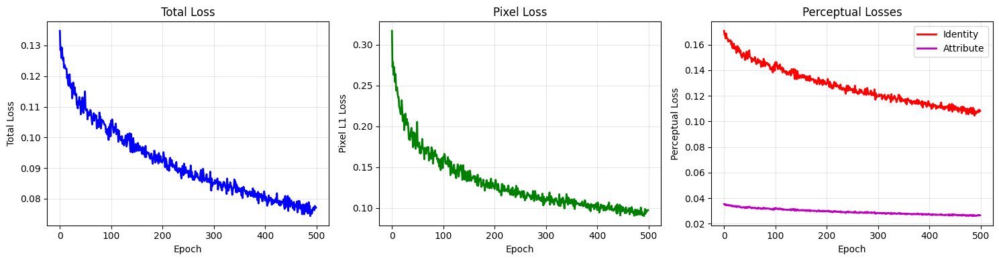

Final losses - Total: 0.0771, Pixel: 0.0972


In [15]:
%matplotlib inline

if 'history' in dir() and history:
    fig, axes = plt.subplots(1, 3, figsize=(15, 4))
    
    axes[0].plot(history['loss'], 'b-', linewidth=2)
    axes[0].set_xlabel('Epoch')
    axes[0].set_ylabel('Total Loss')
    axes[0].set_title('Total Loss')
    axes[0].grid(True, alpha=0.3)
    
    axes[1].plot(history['loss_pixel'], 'g-', linewidth=2)
    axes[1].set_xlabel('Epoch')
    axes[1].set_ylabel('Pixel L1 Loss')
    axes[1].set_title('Pixel Loss')
    axes[1].grid(True, alpha=0.3)
    
    axes[2].plot(history['loss_id'], 'r-', linewidth=2, label='Identity')
    axes[2].plot(history['loss_attr'], 'm-', linewidth=2, label='Attribute')
    axes[2].set_xlabel('Epoch')
    axes[2].set_ylabel('Perceptual Loss')
    axes[2].set_title('Perceptual Losses')
    axes[2].legend()
    axes[2].grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.savefig(str(OUT_DIR / 'finetuning_curves.png'), dpi=150)
    plt.show()
    
    print(f"Final losses - Total: {history['loss'][-1]:.4f}, Pixel: {history['loss_pixel'][-1]:.4f}")

## 11. Test Finetuned Model with Full Pipeline

In [8]:
import random

def analyze_dataset_identities(dataset):
    """Analyze dataset to find all identities."""
    label_to_indices = {}
    for idx in range(len(dataset)):
        _, label = dataset[idx]
        if isinstance(label, torch.Tensor):
            label = label.item()
        if label not in label_to_indices:
            label_to_indices[label] = []
        label_to_indices[label].append(idx)
    return label_to_indices

# Configuration
NUM_SWAPS = 5
FULL_SWAP_DIR = OUT_DIR / 'finetuned_full_swaps'
FULL_SWAP_DIR.mkdir(exist_ok=True, parents=True)

# Load finetuned model
print("Loading finetuned model...")
finetuned_dir = OUT_DIR / 'finetuned_models'
ckpts = sorted(finetuned_dir.glob('*.pth'))

if not ckpts:
    print("No finetuned checkpoints found!")
else:
    latest_ckpt = ckpts[-1]
    print(f"Loading: {latest_ckpt.name}")
    
    ckpt_data = torch.load(str(latest_ckpt), map_location=device)
    arch = ckpt_data.get('arch', 'res_unet.MultiScaleResUNet(in_nc=101,out_nc=3)')
    Gr_finetuned = obj_factory(arch).to(device)
    Gr_finetuned.load_state_dict(ckpt_data['state_dict'])
    Gr_finetuned.eval()
    
    print(f"✓ Loaded epoch {ckpt_data.get('epoch', '?')}")
    
    # Get available identities
    train_identities = analyze_dataset_identities(train_dataset)
    available_labels = list(train_identities.keys())
    
    if len(available_labels) < 2:
        print("Need at least 2 identities!")
    else:
        print(f"\nPerforming {NUM_SWAPS} full pipeline face swaps...")
        
        all_sources = []
        all_targets = []
        all_results = []
        swap_info = []
        
        for i in range(NUM_SWAPS):
            src_label, tgt_label = random.sample(available_labels, 2)
            src_idx = random.choice(train_identities[src_label])
            tgt_idx = random.choice(train_identities[tgt_label])
            
            src_img, _ = train_dataset[src_idx]
            tgt_img, _ = train_dataset[tgt_idx]
            
            # Save temp images
            src_path = FULL_SWAP_DIR / f'temp_src_{i}.png'
            tgt_path = FULL_SWAP_DIR / f'temp_tgt_{i}.png'
            out_path = FULL_SWAP_DIR / f'full_swap_{i}_id{src_label}_pose{tgt_label}.png'
            
            src_np = ((src_img.permute(1, 2, 0).numpy() + 1) / 2 * 255).clip(0, 255).astype('uint8')
            tgt_np = ((tgt_img.permute(1, 2, 0).numpy() + 1) / 2 * 255).clip(0, 255).astype('uint8')
            
            cv2.imwrite(str(src_path), cv2.cvtColor(src_np, cv2.COLOR_RGB2BGR))
            cv2.imwrite(str(tgt_path), cv2.cvtColor(tgt_np, cv2.COLOR_RGB2BGR))
            
            # Run full pipeline with FINETUNED MODEL
            try:
                result_bgr, intermediates, src_crop, tgt_crop = run_full_pipeline(
                    str(src_path), 
                    str(tgt_path), 
                    out_path=str(out_path),
                    reenact=True, 
                    use_detector=True, 
                    device=device,
                    crop_scale=1.2, 
                    resolution=256,
                    G_model=Gr_finetuned
                )
                
                result_rgb = cv2.cvtColor(result_bgr, cv2.COLOR_BGR2RGB)
                
                all_sources.append(src_np)
                all_targets.append(tgt_np)
                all_results.append(result_rgb)
                swap_info.append(f"ID {src_label} → Pose {tgt_label}")
                
                print(f"  {i+1}/{NUM_SWAPS}: ID {src_label} → Pose {tgt_label} ✓")
                
            except Exception as e:
                print(f"  {i+1}/{NUM_SWAPS}: Error - {e}")
        
        print(f"\n✓ Done! Results in: {FULL_SWAP_DIR}")
        
        # Visualize results
        if all_results:
            n_swaps = len(all_results)
            fig, axes = plt.subplots(n_swaps, 3, figsize=(12, 4*n_swaps))
            
            if n_swaps == 1:
                axes = axes.reshape(1, -1)
            
            for i in range(n_swaps):
                axes[i, 0].imshow(all_sources[i])
                axes[i, 0].set_title(f'Source\n{swap_info[i].split("→")[0].strip()}', fontsize=11)
                axes[i, 0].axis('off')
                
                axes[i, 1].imshow(all_targets[i])
                axes[i, 1].set_title(f'Target\n{swap_info[i].split("→")[1].strip()}', fontsize=11)
                axes[i, 1].axis('off')
                
                axes[i, 2].imshow(all_results[i])
                axes[i, 2].set_title(f'Result\n{swap_info[i]}', fontsize=11)
                axes[i, 2].axis('off')
            
            plt.suptitle('Finetuned Model - Face Swap Results', fontsize=14, fontweight='bold')
            plt.tight_layout()
            
            viz_path = FULL_SWAP_DIR / 'all_swaps_visualization.png'
            plt.savefig(str(viz_path), dpi=150, bbox_inches='tight')
            print(f"\n✓ Saved visualization: {viz_path}")
            
            plt.show()

Loading finetuned model...
Loading: reenact_finetuned_epoch100.pth
✓ Loaded epoch 100

Performing 5 full pipeline face swaps...
Using provided G_model (e.g., finetuned)
=> Loading landmarks model: "hr18_wflw_landmarks.pth"...
✓ Loaded epoch 100

Performing 5 full pipeline face swaps...
Using provided G_model (e.g., finetuned)
=> Loading landmarks model: "hr18_wflw_landmarks.pth"...


KeyboardInterrupt: 

## Summary

This notebook:
- ✓ Loaded custom dataset with multiple identities
- ✓ Created paired dataset for reenactment training
- ✓ Finetuned FSGAN reenactment generator on all subjects
- ✓ Evaluated results with full face swap pipeline

**Next step:** For even better quality on a specific person, use `03_per_subject_finetuning.ipynb`

## 12. Compare Base vs Finetuned Models

Compare face swap results between the pretrained base model and your finetuned model.

In [18]:
# Load FaceNet for identity similarity measurement
print("\n4. Loading FaceNet for identity verification...")

try:
    from facenet_pytorch import InceptionResnetV1
    
    # Load pretrained FaceNet model
    facenet = InceptionResnetV1(pretrained='vggface2').eval().to(device)
    
    # Freeze FaceNet parameters
    for param in facenet.parameters():
        param.requires_grad = False
    
    print("   ✓ FaceNet loaded successfully")
    
    # Define preprocessing for FaceNet (expects 160x160, normalized to [-1,1])
    from torchvision import transforms
    facenet_transform = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize((160, 160)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])
    
    def get_facenet_embedding(img_rgb):
        """Extract FaceNet embedding from RGB image (HWC numpy array)."""
        img_tensor = facenet_transform(img_rgb).unsqueeze(0).to(device)
        with torch.no_grad():
            embedding = facenet(img_tensor)
        return embedding
    
    def cosine_similarity(emb1, emb2):
        """Compute cosine similarity between two embeddings."""
        return F.cosine_similarity(emb1, emb2).item()
    
    print("   ✓ FaceNet helper functions defined")
    FACENET_AVAILABLE = True
    
except ImportError:
    print("   ⚠ facenet-pytorch not installed. Run: pip install facenet-pytorch")
    print("   Skipping identity similarity metrics...")
    FACENET_AVAILABLE = False
except Exception as e:
    print(f"   ⚠ Error loading FaceNet: {e}")
    print("   Skipping identity similarity metrics...")
    FACENET_AVAILABLE = False

print("="*60)


4. Loading FaceNet for identity verification...
   ✓ FaceNet loaded successfully
   ✓ FaceNet helper functions defined
   ✓ FaceNet loaded successfully
   ✓ FaceNet helper functions defined


In [16]:
import random

# Configuration
NUM_COMPARISONS = 10
COMPARISON_DIR = OUT_DIR / 'model_comparison'
COMPARISON_DIR.mkdir(exist_ok=True, parents=True)

print("="*60)
print("MODEL COMPARISON: Base vs Finetuned")
print("="*60)

# Load base pretrained model
print("\n1. Loading BASE pretrained model...")
reenact_base_w = WEIGHTS_DIR / 'nfv_msrunet_256_1_2_reenactment_v2.1.pth'
Gr_base, ckpt_base = load_model(str(reenact_base_w), 'reenactment', device=device, return_checkpoint=True)
Gr_base.eval()
print(f"   ✓ Base model loaded: {ckpt_base.get('arch', 'unknown')}")

# Load finetuned model
print("\n2. Loading FINETUNED model...")
finetuned_checkpoint = OUT_DIR / 'finetuned_models' / 'reenact_finetuned_epoch500.pth'

if not finetuned_checkpoint.exists():
    print(f"   ⚠ Checkpoint not found: {finetuned_checkpoint}")
    print("   Looking for any available checkpoint...")
    available_ckpts = sorted((OUT_DIR / 'finetuned_models').glob('*.pth'))
    if available_ckpts:
        finetuned_checkpoint = available_ckpts[-1]
        print(f"   Using: {finetuned_checkpoint.name}")
    else:
        raise FileNotFoundError("No finetuned checkpoints found!")

ckpt_finetuned = torch.load(str(finetuned_checkpoint), map_location=device)
arch = ckpt_finetuned.get('arch', 'res_unet.MultiScaleResUNet(in_nc=101,out_nc=3)')
Gr_finetuned_cmp = obj_factory(arch).to(device)
Gr_finetuned_cmp.load_state_dict(ckpt_finetuned['state_dict'])
Gr_finetuned_cmp.eval()
print(f"   ✓ Finetuned model loaded from epoch {ckpt_finetuned.get('epoch', '?')}")

# Get available identities from dataset
def analyze_dataset_identities(dataset):
    """Analyze dataset to find all identities."""
    label_to_indices = {}
    for idx in range(len(dataset)):
        _, label = dataset[idx]
        if isinstance(label, torch.Tensor):
            label = label.item()
        if label not in label_to_indices:
            label_to_indices[label] = []
        label_to_indices[label].append(idx)
    return label_to_indices

train_identities = analyze_dataset_identities(train_dataset)
available_labels = list(train_identities.keys())

print(f"\n3. Dataset info:")
print(f"   Available identities: {len(available_labels)}")
print(f"   Will perform {NUM_COMPARISONS} comparison swaps")
print("="*60)

MODEL COMPARISON: Base vs Finetuned

1. Loading BASE pretrained model...
=> Loading reenactment model: "nfv_msrunet_256_1_2_reenactment_v2.1.pth"...
   ✓ Base model loaded: res_unet.MultiScaleResUNet(in_nc=101,out_nc=3,flat_layers=(2,2,2,2),ngf=128)

2. Loading FINETUNED model...
   ✓ Base model loaded: res_unet.MultiScaleResUNet(in_nc=101,out_nc=3,flat_layers=(2,2,2,2),ngf=128)

2. Loading FINETUNED model...
   ✓ Finetuned model loaded from epoch 500

3. Dataset info:
   Available identities: 10
   Will perform 10 comparison swaps
   ✓ Finetuned model loaded from epoch 500

3. Dataset info:
   Available identities: 10
   Will perform 10 comparison swaps


In [19]:
# Perform face swaps with both models and compute identity metrics
print("\nPerforming face swaps with both models...\n")

all_sources = []
all_targets = []
all_base_results = []
all_finetuned_results = []
swap_info = []

# Metrics storage
metrics = {
    'base_similarity': [],      # Source vs Base result
    'finetuned_similarity': [], # Source vs Finetuned result
    'improvement': []           # Finetuned - Base
}

for i in range(NUM_COMPARISONS):
    # Select random source and target from different identities
    src_label, tgt_label = random.sample(available_labels, 2)
    src_idx = random.choice(train_identities[src_label])
    tgt_idx = random.choice(train_identities[tgt_label])
    
    src_img, _ = train_dataset[src_idx]
    tgt_img, _ = train_dataset[tgt_idx]
    
    # Save temporary images
    src_path = COMPARISON_DIR / f'temp_src_{i}.png'
    tgt_path = COMPARISON_DIR / f'temp_tgt_{i}.png'
    
    src_np = ((src_img.permute(1, 2, 0).numpy() + 1) / 2 * 255).clip(0, 255).astype('uint8')
    tgt_np = ((tgt_img.permute(1, 2, 0).numpy() + 1) / 2 * 255).clip(0, 255).astype('uint8')
    
    cv2.imwrite(str(src_path), cv2.cvtColor(src_np, cv2.COLOR_RGB2BGR))
    cv2.imwrite(str(tgt_path), cv2.cvtColor(tgt_np, cv2.COLOR_RGB2BGR))
    
    print(f"[{i+1}/{NUM_COMPARISONS}] Identity {src_label} -> Pose {tgt_label}")
    
    # Get source embedding for identity comparison
    if FACENET_AVAILABLE:
        src_embedding = get_facenet_embedding(src_np)
    
    # Run with BASE model
    try:
        base_out_path = COMPARISON_DIR / f'swap_{i}_base_id{src_label}_pose{tgt_label}.png'
        result_base_bgr, _, _, _ = run_full_pipeline(
            str(src_path), 
            str(tgt_path), 
            out_path=str(base_out_path),
            reenact=True, 
            use_detector=True, 
            device=device,
            crop_scale=1.2, 
            resolution=256,
            G_model=Gr_base
        )
        result_base_rgb = cv2.cvtColor(result_base_bgr, cv2.COLOR_BGR2RGB)
        
        # Compute identity similarity
        if FACENET_AVAILABLE:
            base_embedding = get_facenet_embedding(result_base_rgb)
            base_sim = cosine_similarity(src_embedding, base_embedding)
            metrics['base_similarity'].append(base_sim)
            print(f"  ✓ Base model (similarity: {base_sim:.4f})")
        else:
            print(f"  ✓ Base model")
            
    except Exception as e:
        print(f"  ✗ Base model failed: {e}")
        result_base_rgb = np.zeros_like(src_np)
        if FACENET_AVAILABLE:
            metrics['base_similarity'].append(0.0)
    
    # Run with FINETUNED model
    try:
        finetuned_out_path = COMPARISON_DIR / f'swap_{i}_finetuned_id{src_label}_pose{tgt_label}.png'
        result_finetuned_bgr, _, _, _ = run_full_pipeline(
            str(src_path), 
            str(tgt_path), 
            out_path=str(finetuned_out_path),
            reenact=True, 
            use_detector=True, 
            device=device,
            crop_scale=1.2, 
            resolution=256,
            G_model=Gr_finetuned_cmp
        )
        result_finetuned_rgb = cv2.cvtColor(result_finetuned_bgr, cv2.COLOR_BGR2RGB)
        
        # Compute identity similarity
        if FACENET_AVAILABLE:
            finetuned_embedding = get_facenet_embedding(result_finetuned_rgb)
            finetuned_sim = cosine_similarity(src_embedding, finetuned_embedding)
            metrics['finetuned_similarity'].append(finetuned_sim)
            
            # Calculate improvement
            improvement = finetuned_sim - metrics['base_similarity'][-1]
            metrics['improvement'].append(improvement)
            
            improvement_str = f"+{improvement:.4f}" if improvement > 0 else f"{improvement:.4f}"
            print(f"  ✓ Finetuned model (similarity: {finetuned_sim:.4f}, Δ: {improvement_str})")
        else:
            print(f"  ✓ Finetuned model")
            
    except Exception as e:
        print(f"  ✗ Finetuned model failed: {e}")
        result_finetuned_rgb = np.zeros_like(src_np)
        if FACENET_AVAILABLE:
            metrics['finetuned_similarity'].append(0.0)
            metrics['improvement'].append(0.0)
    
    all_sources.append(src_np)
    all_targets.append(tgt_np)
    all_base_results.append(result_base_rgb)
    all_finetuned_results.append(result_finetuned_rgb)
    swap_info.append(f"ID {src_label} → Pose {tgt_label}")
    print()

print(f"✓ Completed {NUM_COMPARISONS} comparisons")
print(f"✓ Results saved to: {COMPARISON_DIR}")

# Print summary statistics
if FACENET_AVAILABLE and metrics['base_similarity']:
    print("\n" + "="*60)
    print("IDENTITY SIMILARITY METRICS (FaceNet Cosine Similarity)")
    print("="*60)
    print(f"Base Model Average:      {np.mean(metrics['base_similarity']):.4f} ± {np.std(metrics['base_similarity']):.4f}")
    print(f"Finetuned Model Average: {np.mean(metrics['finetuned_similarity']):.4f} ± {np.std(metrics['finetuned_similarity']):.4f}")
    print(f"Average Improvement:     {np.mean(metrics['improvement']):.4f}")
    print(f"Improvements > 0:        {sum(1 for x in metrics['improvement'] if x > 0)}/{len(metrics['improvement'])} swaps")
    print("="*60)


Performing face swaps with both models...

[1/10] Identity 8 -> Pose 1
Using provided G_model (e.g., finetuned)
=> Loading landmarks model: "hr18_wflw_landmarks.pth"...


/home/e20220005499/Documents/Face-Swap-M2/venv/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/e20220005499/Documents/Face-Swap-M2/venv/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet152_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet152_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


face detected
face detected
=> Loading segmentation model: "celeba_unet_256_1_2_segmentation_v2.pth"...
face detected
=> Loading segmentation model: "celeba_unet_256_1_2_segmentation_v2.pth"...
=> Loading completion model: "ijbc_msrunet_256_1_2_inpainting_v2.pth"...
=> Loading completion model: "ijbc_msrunet_256_1_2_inpainting_v2.pth"...
=> Loading blending model: "ijbc_msrunet_256_1_2_blending_v2.pth"...
=> Loading blending model: "ijbc_msrunet_256_1_2_blending_v2.pth"...


/home/e20220005499/Documents/Face-Swap-M2/venv/lib/python3.10/site-packages/torch/functional.py:539: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /pytorch/aten/src/ATen/native/TensorShape.cpp:3637.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


  ✓ Base model (similarity: 0.4492)
Using provided G_model (e.g., finetuned)
=> Loading landmarks model: "hr18_wflw_landmarks.pth"...
face detected
face detected
face detected
=> Loading segmentation model: "celeba_unet_256_1_2_segmentation_v2.pth"...
face detected
=> Loading segmentation model: "celeba_unet_256_1_2_segmentation_v2.pth"...
=> Loading completion model: "ijbc_msrunet_256_1_2_inpainting_v2.pth"...
=> Loading completion model: "ijbc_msrunet_256_1_2_inpainting_v2.pth"...
=> Loading blending model: "ijbc_msrunet_256_1_2_blending_v2.pth"...
=> Loading blending model: "ijbc_msrunet_256_1_2_blending_v2.pth"...
  ✓ Finetuned model (similarity: 0.2817, Δ: -0.1674)

[2/10] Identity 8 -> Pose 6
Using provided G_model (e.g., finetuned)
=> Loading landmarks model: "hr18_wflw_landmarks.pth"...
  ✓ Finetuned model (similarity: 0.2817, Δ: -0.1674)

[2/10] Identity 8 -> Pose 6
Using provided G_model (e.g., finetuned)
=> Loading landmarks model: "hr18_wflw_landmarks.pth"...
face detected


/tmp/ipykernel_46487/1534831357.py:34: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  bp = axes[2].boxplot(box_data, labels=['Base', 'Finetuned'], patch_artist=True,



✓ Saved metrics visualization: outputs/model_comparison/identity_similarity_metrics.png


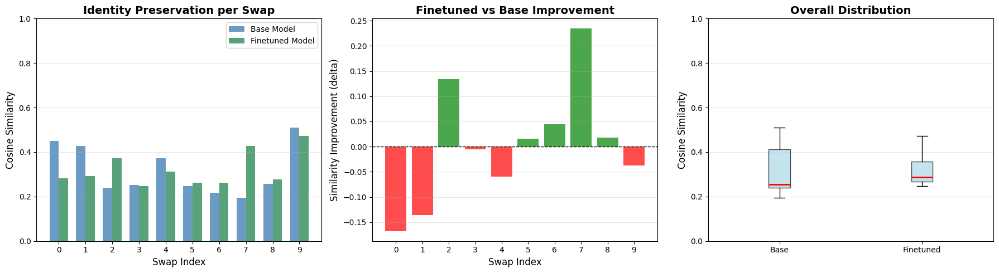

In [21]:
%matplotlib inline
#  Visualize identity similarity metrics
if FACENET_AVAILABLE and metrics['base_similarity']:
    
    
    fig, axes = plt.subplots(1, 3, figsize=(18, 5))
    
    # Plot 1: Bar comparison
    x = np.arange(NUM_COMPARISONS)
    width = 0.35
    
    axes[0].bar(x - width/2, metrics['base_similarity'], width, label='Base Model', color='steelblue', alpha=0.8)
    axes[0].bar(x + width/2, metrics['finetuned_similarity'], width, label='Finetuned Model', color='seagreen', alpha=0.8)
    axes[0].set_xlabel('Swap Index', fontsize=12)
    axes[0].set_ylabel('Cosine Similarity', fontsize=12)
    axes[0].set_title('Identity Preservation per Swap', fontsize=14, fontweight='bold')
    axes[0].set_xticks(x)
    axes[0].legend()
    axes[0].grid(True, alpha=0.3, axis='y')
    axes[0].set_ylim([0, 1])
    
    # Plot 2: Improvement delta
    colors = ['green' if x > 0 else 'red' for x in metrics['improvement']]
    axes[1].bar(x, metrics['improvement'], color=colors, alpha=0.7)
    axes[1].axhline(y=0, color='black', linestyle='--', linewidth=1)
    axes[1].set_xlabel('Swap Index', fontsize=12)
    axes[1].set_ylabel('Similarity Improvement (delta)', fontsize=12)
    axes[1].set_title('Finetuned vs Base Improvement', fontsize=14, fontweight='bold')
    axes[1].set_xticks(x)
    axes[1].grid(True, alpha=0.3, axis='y')
    
    # Plot 3: Box plot comparison
    box_data = [metrics['base_similarity'], metrics['finetuned_similarity']]
    bp = axes[2].boxplot(box_data, labels=['Base', 'Finetuned'], patch_artist=True,
                          boxprops=dict(facecolor='lightblue', alpha=0.7),
                          medianprops=dict(color='red', linewidth=2))
    axes[2].set_ylabel('Cosine Similarity', fontsize=12)
    axes[2].set_title('Overall Distribution', fontsize=14, fontweight='bold')
    axes[2].grid(True, alpha=0.3, axis='y')
    axes[2].set_ylim([0, 1])
    
    plt.tight_layout()
    
    # Save metrics plot
    metrics_plot_path = COMPARISON_DIR / 'identity_similarity_metrics.png'
    plt.savefig(str(metrics_plot_path), dpi=150, bbox_inches='tight')
    print(f"\n✓ Saved metrics visualization: {metrics_plot_path}")
    
    plt.show()


✓ Saved comparison visualization: outputs/model_comparison/comparison_visualization.png


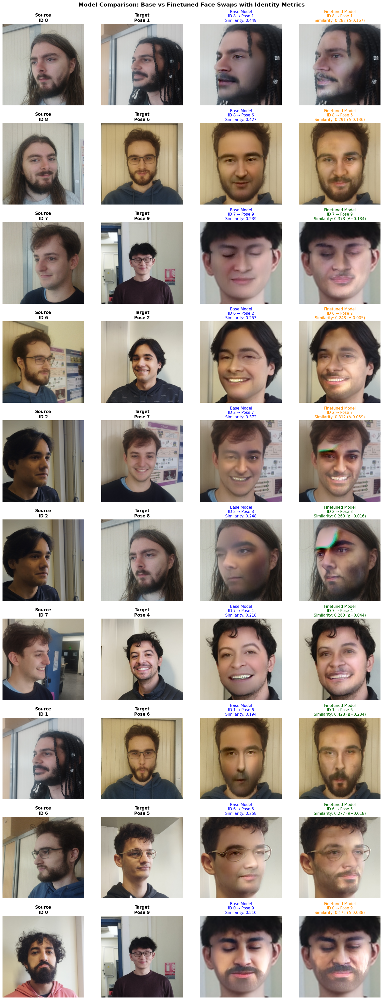

In [22]:
# Visualize comparison results with similarity scores
%matplotlib inline

fig, axes = plt.subplots(NUM_COMPARISONS, 4, figsize=(16, 4*NUM_COMPARISONS))

if NUM_COMPARISONS == 1:
    axes = axes.reshape(1, -1)

for i in range(NUM_COMPARISONS):
    # Source image
    axes[i, 0].imshow(all_sources[i])
    axes[i, 0].set_title(f'Source\n{swap_info[i].split("→")[0].strip()}', fontsize=12, fontweight='bold')
    axes[i, 0].axis('off')
    
    # Target image
    axes[i, 1].imshow(all_targets[i])
    axes[i, 1].set_title(f'Target\n{swap_info[i].split("→")[1].strip()}', fontsize=12, fontweight='bold')
    axes[i, 1].axis('off')
    
    # Base model result with similarity score
    axes[i, 2].imshow(all_base_results[i])
    if FACENET_AVAILABLE and i < len(metrics['base_similarity']):
        sim_score = metrics['base_similarity'][i]
        title = f'Base Model\n{swap_info[i]}\nSimilarity: {sim_score:.3f}'
    else:
        title = f'Base Model\n{swap_info[i]}'
    axes[i, 2].set_title(title, fontsize=11, color='blue')
    axes[i, 2].axis('off')
    
    # Finetuned model result with similarity score and improvement
    axes[i, 3].imshow(all_finetuned_results[i])
    if FACENET_AVAILABLE and i < len(metrics['finetuned_similarity']):
        sim_score = metrics['finetuned_similarity'][i]
        improvement = metrics['improvement'][i]
        improvement_str = f"+{improvement:.3f}" if improvement > 0 else f"{improvement:.3f}"
        title = f'Finetuned Model\n{swap_info[i]}\nSimilarity: {sim_score:.3f} (Δ{improvement_str})'
        title_color = 'darkgreen' if improvement > 0 else 'darkorange'
    else:
        title = f'Finetuned Model\n{swap_info[i]}'
        title_color = 'green'
    axes[i, 3].set_title(title, fontsize=11, color=title_color)
    axes[i, 3].axis('off')

plt.suptitle('Model Comparison: Base vs Finetuned Face Swaps with Identity Metrics', 
             fontsize=16, fontweight='bold', y=0.995)
plt.tight_layout()

# Save visualization
viz_path = COMPARISON_DIR / 'comparison_visualization.png'
plt.savefig(str(viz_path), dpi=150, bbox_inches='tight')
print(f"\n✓ Saved comparison visualization: {viz_path}")

plt.show()

### Comparison Analysis

**What to look for:**
- **Identity preservation:** Does the result maintain the source person's facial features?
- **Pose/expression transfer:** Does the result adopt the target's pose and expression?
- **Quality:** Are there artifacts, blurriness, or unnatural features?
- **Dataset adaptation:** The finetuned model should perform better on faces similar to your dataset

**Expected improvements:**
- Better facial feature preservation for identities in your dataset
- More natural blending and fewer artifacts
- Improved handling of dataset-specific characteristics (lighting, angles, etc.)

In [24]:
## 13. Direct Reenactment Comparison (No Full Pipeline)

"""
This cell compares ONLY the reenactment generator outputs (base vs finetuned)
without face detection, segmentation, or blending - just pure reenactment.
Tests CROSS-PERSON reenactment (different identities).
"""

import random

# Configuration
NUM_REENACT_TESTS = 50
REENACT_COMPARISON_DIR = OUT_DIR / 'reenactment_only_comparison'
REENACT_COMPARISON_DIR.mkdir(exist_ok=True, parents=True)

print("="*60)
print("REENACTMENT-ONLY COMPARISON: Base vs Finetuned")
print("="*60)

# Ensure models are loaded
if 'Gr_base' not in dir():
    print("\n1. Loading BASE reenactment model...")
    reenact_base_w = WEIGHTS_DIR / 'nfv_msrunet_256_1_2_reenactment_v2.1.pth'
    Gr_base, ckpt_base = load_model(str(reenact_base_w), 'reenactment', device=device, return_checkpoint=True)
    Gr_base.eval()
    print(f"   ✓ Base model loaded: {ckpt_base.get('arch', 'unknown')}")

if 'Gr_finetuned_cmp' not in dir():
    print("\n2. Loading FINETUNED reenactment model...")
    finetuned_checkpoint = OUT_DIR / 'finetuned_models' / 'reenact_finetuned_epoch500.pth'
    
    if not finetuned_checkpoint.exists():
        print(f"   ⚠ Checkpoint not found: {finetuned_checkpoint}")
        print("   Looking for any available checkpoint...")
        available_ckpts = sorted((OUT_DIR / 'finetuned_models').glob('*.pth'))
        if available_ckpts:
            finetuned_checkpoint = available_ckpts[-1]
            print(f"   Using: {finetuned_checkpoint.name}")
        else:
            raise FileNotFoundError("No finetuned checkpoints found!")
    
    ckpt_finetuned = torch.load(str(finetuned_checkpoint), map_location=device)
    arch = ckpt_finetuned.get('arch', 'res_unet.MultiScaleResUNet(in_nc=101,out_nc=3)')
    Gr_finetuned_cmp = obj_factory(arch).to(device)
    Gr_finetuned_cmp.load_state_dict(ckpt_finetuned['state_dict'])
    Gr_finetuned_cmp.eval()
    print(f"   ✓ Finetuned model loaded from epoch {ckpt_finetuned.get('epoch', '?')}")

# Ensure landmarks model is loaded
if 'L_frozen' not in dir():
    print("\n3. Loading landmarks model...")
    lms_w = WEIGHTS_DIR / 'hr18_wflw_landmarks.pth'
    L_frozen, _ = load_model(str(lms_w), 'landmarks', device=device, return_checkpoint=True)
    L_frozen.eval()
    for param in L_frozen.parameters():
        param.requires_grad = False
    print("   ✓ Landmarks model loaded")

print(f"\n4. Dataset: {len(available_labels)} identities available")
print(f"   Will perform {NUM_REENACT_TESTS} cross-person reenactment tests")
print("="*60)

# Storage for results
reenact_sources = []
reenact_targets = []
reenact_base_outputs = []
reenact_finetuned_outputs = []
reenact_info = []

# Metrics storage
reenact_metrics = {
    'base_similarity': [],      # Source vs Base reenactment
    'finetuned_similarity': [], # Source vs Finetuned reenactment
    'improvement': [],          # Finetuned - Base
    'pixel_l1_base': [],        # L1 distance: base output vs target
    'pixel_l1_finetuned': []    # L1 distance: finetuned output vs target
}

print("\nPerforming direct reenactment tests (cross-person)...\n")

with torch.no_grad():
    for i in range(NUM_REENACT_TESTS):
        # Select random source and target from DIFFERENT people (cross-person reenactment)
        # Tests identity preservation when transferring pose from different person
        src_label, tgt_label = random.sample(available_labels, 2)
        
        # Get one image from each person
        src_idx = random.choice(train_identities[src_label])
        tgt_idx = random.choice(train_identities[tgt_label])
        
        src_img, _ = train_dataset[src_idx]
        tgt_img, _ = train_dataset[tgt_idx]
        
        # Move to device and add batch dimension
        src_batch = src_img.unsqueeze(0).to(device)
        tgt_batch = tgt_img.unsqueeze(0).to(device)
        
        print(f"[{i+1}/{NUM_REENACT_TESTS}] Source ID {src_label} -> Target ID {tgt_label} (cross-person)")
        
        # Prepare reenactment inputs (source image + target landmarks)
        input_list, tgt_normalized = prepare_reenactment_input(
            src_batch, tgt_batch, L_frozen, n_levels, device
        )
        
        # Get source embedding for identity verification
        src_np = ((src_img.permute(1, 2, 0).cpu().numpy() + 1) / 2 * 255).clip(0, 255).astype('uint8')
        tgt_np = ((tgt_img.permute(1, 2, 0).cpu().numpy() + 1) / 2 * 255).clip(0, 255).astype('uint8')
        
        if FACENET_AVAILABLE:
            src_embedding = get_facenet_embedding(src_np)
        
        # BASE MODEL REENACTMENT
        output_base = Gr_base(input_list)
        pred_base = output_base[-1] if isinstance(output_base, (list, tuple)) else output_base
        pred_base_np = tensor2bgr(pred_base[0])
        pred_base_rgb = cv2.cvtColor(pred_base_np, cv2.COLOR_BGR2RGB)
        
        # Compute base metrics
        if FACENET_AVAILABLE:
            base_emb = get_facenet_embedding(pred_base_rgb)
            base_sim = cosine_similarity(src_embedding, base_emb)
            reenact_metrics['base_similarity'].append(base_sim)
        
        # Pixel-wise L1 loss with target
        pixel_l1_base = F.l1_loss(pred_base, tgt_normalized).item()
        reenact_metrics['pixel_l1_base'].append(pixel_l1_base)
        
        # FINETUNED MODEL REENACTMENT
        output_finetuned = Gr_finetuned_cmp(input_list)
        pred_finetuned = output_finetuned[-1] if isinstance(output_finetuned, (list, tuple)) else output_finetuned
        pred_finetuned_np = tensor2bgr(pred_finetuned[0])
        pred_finetuned_rgb = cv2.cvtColor(pred_finetuned_np, cv2.COLOR_BGR2RGB)
        
        # Compute finetuned metrics
        if FACENET_AVAILABLE:
            finetuned_emb = get_facenet_embedding(pred_finetuned_rgb)
            finetuned_sim = cosine_similarity(src_embedding, finetuned_emb)
            reenact_metrics['finetuned_similarity'].append(finetuned_sim)
            
            improvement = finetuned_sim - base_sim
            reenact_metrics['improvement'].append(improvement)
            
            improvement_str = f"+{improvement:.4f}" if improvement > 0 else f"{improvement:.4f}"
            print(f"  Identity similarity - Base: {base_sim:.4f}, Finetuned: {finetuned_sim:.4f}, Δ: {improvement_str}")
        
        # Pixel-wise L1 loss with target
        pixel_l1_finetuned = F.l1_loss(pred_finetuned, tgt_normalized).item()
        reenact_metrics['pixel_l1_finetuned'].append(pixel_l1_finetuned)
        
        pixel_improvement = pixel_l1_base - pixel_l1_finetuned
        pixel_improvement_str = f"-{abs(pixel_improvement):.4f}" if pixel_improvement > 0 else f"+{abs(pixel_improvement):.4f}"
        print(f"  Pixel L1 loss     - Base: {pixel_l1_base:.4f}, Finetuned: {pixel_l1_finetuned:.4f}, Δ: {pixel_improvement_str}")
        
        # Store results
        reenact_sources.append(src_np)
        reenact_targets.append(tgt_np)
        reenact_base_outputs.append(pred_base_rgb)
        reenact_finetuned_outputs.append(pred_finetuned_rgb)
        reenact_info.append(f"ID {src_label} → ID {tgt_label}")
        
        # Save individual results
        cv2.imwrite(str(REENACT_COMPARISON_DIR / f'reenact_{i}_source_id{src_label}.png'), 
                    cv2.cvtColor(src_np, cv2.COLOR_RGB2BGR))
        cv2.imwrite(str(REENACT_COMPARISON_DIR / f'reenact_{i}_target_id{tgt_label}.png'), 
                    cv2.cvtColor(tgt_np, cv2.COLOR_RGB2BGR))
        cv2.imwrite(str(REENACT_COMPARISON_DIR / f'reenact_{i}_base_id{src_label}_to_id{tgt_label}.png'), 
                    pred_base_np)
        cv2.imwrite(str(REENACT_COMPARISON_DIR / f'reenact_{i}_finetuned_id{src_label}_to_id{tgt_label}.png'), 
                    pred_finetuned_np)
        
        print()

print(f"✓ Completed {len(reenact_sources)} cross-person reenactment tests")
print(f"✓ Results saved to: {REENACT_COMPARISON_DIR}")

# Print summary statistics
print("\n" + "="*60)
print("REENACTMENT METRICS SUMMARY (Cross-Person)")
print("="*60)

if FACENET_AVAILABLE and reenact_metrics['base_similarity']:
    print("\nIdentity Preservation (FaceNet Cosine Similarity):")
    print(f"  Base Model:      {np.mean(reenact_metrics['base_similarity']):.4f} ± {np.std(reenact_metrics['base_similarity']):.4f}")
    print(f"  Finetuned Model: {np.mean(reenact_metrics['finetuned_similarity']):.4f} ± {np.std(reenact_metrics['finetuned_similarity']):.4f}")
    print(f"  Avg Improvement: {np.mean(reenact_metrics['improvement']):.4f}")
    print(f"  Better results:  {sum(1 for x in reenact_metrics['improvement'] if x > 0)}/{len(reenact_metrics['improvement'])} tests")

if reenact_metrics['pixel_l1_base']:
    print("\nPixel Reconstruction (L1 Loss with Target):")
    print(f"  Base Model:      {np.mean(reenact_metrics['pixel_l1_base']):.4f} ± {np.std(reenact_metrics['pixel_l1_base']):.4f}")
    print(f"  Finetuned Model: {np.mean(reenact_metrics['pixel_l1_finetuned']):.4f} ± {np.std(reenact_metrics['pixel_l1_finetuned']):.4f}")
    
    pixel_improvements = [reenact_metrics['pixel_l1_base'][i] - reenact_metrics['pixel_l1_finetuned'][i] 
                         for i in range(len(reenact_metrics['pixel_l1_base']))]
    print(f"  Avg Improvement: {np.mean(pixel_improvements):.4f} (lower is better)")
    print(f"  Better results:  {sum(1 for x in pixel_improvements if x > 0)}/{len(pixel_improvements)} tests")

print("="*60)

REENACTMENT-ONLY COMPARISON: Base vs Finetuned

4. Dataset: 10 identities available
   Will perform 50 cross-person reenactment tests

Performing direct reenactment tests (cross-person)...

[1/50] Source ID 8 -> Target ID 2 (cross-person)
  Identity similarity - Base: 0.7710, Finetuned: 0.6809, Δ: -0.0901
  Pixel L1 loss     - Base: 0.3552, Finetuned: 0.3013, Δ: -0.0539

[2/50] Source ID 4 -> Target ID 0 (cross-person)
  Identity similarity - Base: 0.1891, Finetuned: 0.4692, Δ: +0.2801
  Pixel L1 loss     - Base: 0.3332, Finetuned: 0.2711, Δ: -0.0621

[3/50] Source ID 3 -> Target ID 2 (cross-person)
  Identity similarity - Base: 0.0063, Finetuned: -0.0650, Δ: -0.0713
  Pixel L1 loss     - Base: 0.5728, Finetuned: 0.2242, Δ: -0.3486
  Identity similarity - Base: 0.1891, Finetuned: 0.4692, Δ: +0.2801
  Pixel L1 loss     - Base: 0.3332, Finetuned: 0.2711, Δ: -0.0621

[3/50] Source ID 3 -> Target ID 2 (cross-person)
  Identity similarity - Base: 0.0063, Finetuned: -0.0650, Δ: -0.0713
  Pix


✓ Saved visualization: outputs/reenactment_only_comparison/reenactment_comparison_grid.png


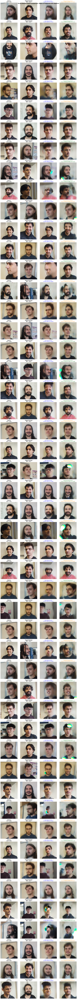

/tmp/ipykernel_46487/3944432727.py:105: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  bp = axes[3].boxplot(box_data, labels=['Base', 'Finetuned'],


✓ Saved metrics visualization: outputs/reenactment_only_comparison/reenactment_metrics.png


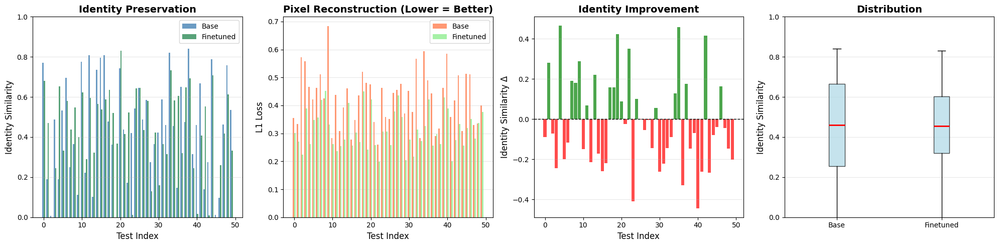

In [25]:
# Visualize reenactment-only comparison
%matplotlib inline

if reenact_sources:
    n_tests = len(reenact_sources)
    
    # Main comparison grid
    fig, axes = plt.subplots(n_tests, 4, figsize=(16, 4*n_tests))
    
    if n_tests == 1:
        axes = axes.reshape(1, -1)
    
    for i in range(n_tests):
        # Source image
        axes[i, 0].imshow(reenact_sources[i])
        axes[i, 0].set_title(f'Source\n{reenact_info[i]}', fontsize=12, fontweight='bold')
        axes[i, 0].axis('off')
        
        # Target image (driving pose/expression)
        axes[i, 1].imshow(reenact_targets[i])
        axes[i, 1].set_title(f'Target (Driving)\n{reenact_info[i]}', fontsize=12, fontweight='bold')
        axes[i, 1].axis('off')
        
        # Base model reenactment
        axes[i, 2].imshow(reenact_base_outputs[i])
        if FACENET_AVAILABLE and i < len(reenact_metrics['base_similarity']):
            sim = reenact_metrics['base_similarity'][i]
            l1 = reenact_metrics['pixel_l1_base'][i]
            title = f'Base Reenactment\nID Sim: {sim:.3f} | L1: {l1:.4f}'
        else:
            title = f'Base Reenactment\n{reenact_info[i]}'
        axes[i, 2].set_title(title, fontsize=11, color='blue')
        axes[i, 2].axis('off')
        
        # Finetuned model reenactment
        axes[i, 3].imshow(reenact_finetuned_outputs[i])
        if FACENET_AVAILABLE and i < len(reenact_metrics['finetuned_similarity']):
            sim = reenact_metrics['finetuned_similarity'][i]
            l1 = reenact_metrics['pixel_l1_finetuned'][i]
            imp = reenact_metrics['improvement'][i]
            imp_str = f"+{imp:.3f}" if imp > 0 else f"{imp:.3f}"
            title = f'Finetuned Reenactment\nID Sim: {sim:.3f} (Δ{imp_str}) | L1: {l1:.4f}'
            title_color = 'darkgreen' if imp > 0 else 'darkorange'
        else:
            title = f'Finetuned Reenactment\n{reenact_info[i]}'
            title_color = 'green'
        axes[i, 3].set_title(title, fontsize=11, color=title_color)
        axes[i, 3].axis('off')
    
    plt.suptitle('Direct Reenactment Comparison: Base vs Finetuned (No Pipeline)', 
                 fontsize=16, fontweight='bold', y=0.995)
    plt.tight_layout()
    
    # Save visualization
    viz_path = REENACT_COMPARISON_DIR / 'reenactment_comparison_grid.png'
    plt.savefig(str(viz_path), dpi=150, bbox_inches='tight')
    print(f"\n✓ Saved visualization: {viz_path}")
    
    plt.show()
    
    # Metrics visualization
    if FACENET_AVAILABLE and reenact_metrics['base_similarity']:
        fig, axes = plt.subplots(1, 4, figsize=(20, 5))
        
        x = np.arange(n_tests)
        width = 0.35
        
        # Plot 1: Identity similarity comparison
        axes[0].bar(x - width/2, reenact_metrics['base_similarity'], width, 
                   label='Base', color='steelblue', alpha=0.8)
        axes[0].bar(x + width/2, reenact_metrics['finetuned_similarity'], width, 
                   label='Finetuned', color='seagreen', alpha=0.8)
        axes[0].set_xlabel('Test Index', fontsize=12)
        axes[0].set_ylabel('Identity Similarity', fontsize=12)
        axes[0].set_title('Identity Preservation', fontsize=14, fontweight='bold')
        axes[0].legend()
        axes[0].grid(True, alpha=0.3, axis='y')
        axes[0].set_ylim([0, 1])
        
        # Plot 2: Pixel L1 comparison (lower is better)
        axes[1].bar(x - width/2, reenact_metrics['pixel_l1_base'], width, 
                   label='Base', color='coral', alpha=0.8)
        axes[1].bar(x + width/2, reenact_metrics['pixel_l1_finetuned'], width, 
                   label='Finetuned', color='lightgreen', alpha=0.8)
        axes[1].set_xlabel('Test Index', fontsize=12)
        axes[1].set_ylabel('L1 Loss', fontsize=12)
        axes[1].set_title('Pixel Reconstruction (Lower = Better)', fontsize=14, fontweight='bold')
        axes[1].legend()
        axes[1].grid(True, alpha=0.3, axis='y')
        
        # Plot 3: Identity improvement
        colors = ['green' if x > 0 else 'red' for x in reenact_metrics['improvement']]
        axes[2].bar(x, reenact_metrics['improvement'], color=colors, alpha=0.7)
        axes[2].axhline(y=0, color='black', linestyle='--', linewidth=1)
        axes[2].set_xlabel('Test Index', fontsize=12)
        axes[2].set_ylabel('Identity Similarity Δ', fontsize=12)
        axes[2].set_title('Identity Improvement', fontsize=14, fontweight='bold')
        axes[2].grid(True, alpha=0.3, axis='y')
        
        # Plot 4: Box plots
        box_data = [
            reenact_metrics['base_similarity'],
            reenact_metrics['finetuned_similarity']
        ]
        bp = axes[3].boxplot(box_data, labels=['Base', 'Finetuned'], 
                            patch_artist=True,
                            boxprops=dict(facecolor='lightblue', alpha=0.7),
                            medianprops=dict(color='red', linewidth=2))
        axes[3].set_ylabel('Identity Similarity', fontsize=12)
        axes[3].set_title('Distribution', fontsize=14, fontweight='bold')
        axes[3].grid(True, alpha=0.3, axis='y')
        axes[3].set_ylim([0, 1])
        
        plt.tight_layout()
        
        metrics_viz_path = REENACT_COMPARISON_DIR / 'reenactment_metrics.png'
        plt.savefig(str(metrics_viz_path), dpi=150, bbox_inches='tight')
        print(f"✓ Saved metrics visualization: {metrics_viz_path}")
        
        plt.show()